In [1]:
rm(list=ls())
setwd('/data/users/jiancheng.zhai/project/ml/clustering/company_clustering/data/finance')
getwd()

[1] "/data/users/jiancheng.zhai/project/ml/clustering/company_clustering/data/finance"

In [2]:

library(Matrix)
library(parallel)
library(skmeans)
library(slam)
library(cluster)
library(pvclust)
library(mclust)
library(flexclust)
options(scipen=200) 
options(jupyter.plot_mimetypes = 'image/png')


Attaching package: ‘Matrix’

The following objects are masked from ‘package:base’:

    crossprod, tcrossprod

Package 'mclust' version 5.1
Type 'citation("mclust")' for citing this R package in publications.
Loading required package: grid
Loading required package: lattice
Warning message:
: package ‘lattice’ was built under R version 3.2.0Loading required package: modeltools
Loading required package: stats4


In [3]:
library(kknn)
library(reshape2)
library(scuba)
library(kernlab)

scuba 1.8-0 
Type ‘help(scuba)’ for an introduction 
Read the warnings in ‘help(scuba.disclaimer)’ 
For news about changes to the package, type ‘news(package='scuba')’

Attaching package: ‘kernlab’

The following object is masked from ‘package:scuba’:

    param

The following object is masked from ‘package:flexclust’:

    kcca

The following object is masked from ‘package:modeltools’:

    prior



In [4]:
library(clValid)


Attaching package: ‘clValid’

The following object is masked from ‘package:flexclust’:

    clusters

The following object is masked from ‘package:modeltools’:

    clusters



In [5]:
read.file.func <- function(file.path){                                                                                                  
     d <- read.csv(file=file.path,                                                                                                       
                   header=F,                                                                                                             
                   stringsAsFactors=F,                                                                                                   
                   sep='\t')                                                                                                             
                                                                                                                                         
     return(d)                                                                                                                           
}                     

In [243]:
sim.file <- "../tools/wcos_general/url_sim"
sim.data <- read.file.func(sim.file)

In [288]:
trim.sim.data.func <- function(sim.data){
    col.names <- sim.data$V1
    sim.data$V1 <- NULL
    colnames(sim.data) <- col.names
    rownames(sim.data) <- col.names
    return(sim.data)
}

In [131]:
intern <- clValid(sim.data, 2:6, clMethods=c("hierarchical", "kmeans", "pam"), validation="internal")

In [132]:
summary(intern)


Clustering Methods:
 hierarchical kmeans pam 

Cluster sizes:
 2 3 4 5 6 

Validation Measures:
                                  2        3        4        5        6
                                                                       
hierarchical Connectivity   14.5837  33.9972  35.6306  35.9972  42.9147
             Dunn            0.2549   0.3061   0.3061   0.3061   0.3117
             Silhouette      0.6147   0.5695   0.5642   0.5599   0.5347
kmeans       Connectivity   13.4671  39.8083  48.5060  66.3397  68.0496
             Dunn            0.2549   0.2448   0.2235   0.2348   0.2348
             Silhouette      0.6171   0.5494   0.4816   0.4357   0.4634
pam          Connectivity   13.4671  45.7996  88.7956  91.2821 103.3996
             Dunn            0.2549   0.2034   0.0837   0.0837   0.0967
             Silhouette      0.6171   0.4689   0.2133   0.2088   0.2090

Optimal Scores:

             Score   Method       Clusters
Connectivity 13.4671 kmeans       2       
Dunn   

In [66]:
head(sim.data)

,5662,5656,5634,5623,5606,5592,5532,5529,5527,5495,5489,5485,5481,5475,5463,5460,5447,5438,5418,5403,5384,5380,5372,5354,5347,5340,5320,5316,5311,5292,5280,5270,5263,5258,5253,5233,5231,5198,5190,5165,5155,5119,5113,5103,5086,5081,5061,5047,5030,5019,5000,4999,4998,4992,4991,4986,4975,4974,4946,4911,4883,4878,4852,4828,4824,4754,4735,4614,4570,4561,4560,4554,4545,4522,4477,4469,4462,4421,4361,4345,4286,4275,4271,4261,4246,4240,4209,4206,4195,4132,4120,4105,4101,4099,4095,4087,4082,4073,4069,4067,4046,4038,4004,4002,3998,3986,3954,3951,3950,3934,3929,3926,3924,3906,3903,3902,3898,3895,3880,3849,3843,3833,3830,3825,3820,3812,3811,3790,3766,3764,3747,3744,3743,3741,3734,3733,3731,3719,3718,3694,3676,3644,3624,3607,3603,3598,3590,3584,3566,3558,3547,3546,3543,3521,3498,3493,3448,3442,3435,3426,3424,3410,3407,3405,3399,3398,3396,3387,3372,3363,3361,3354,3353,3350,3344,3335,3323,3301,3299,3281,3269,3264,3249,3222,3215,3184,3170,3166,3146,3145,3122,3119,3115,3109,3107,3106,3029,3023,3021,3003,2999,2996,2936,2934,2922,2915,2910,2897,2893,2892,2872,2868,2867,2862,2856,2841,2834,2831,2819,2817,2814,2811,2799,2784,2776,2772,2763,2754,2740,2738,2722,2715,2706,2688,2642,2619,2618,2600,2590,2589,2574,2548,2546,2543,2536,2530,2529,2528,2527,2520,2487,2482,2469,2455,2447,2441,2435,2428,2417,2405,2393,2392,2388,2382,2377,2357,2355,2327,2320,2317,2310,2272,2270,2257,2248,2246,2219,2211,2202,2193,2192,2160,2150,2147,2128,2120,2110,2089,2080,2065,2062,2025,2019,2010,1976,1961,1953,1941,1918,1910,1901,1899,1877,1876,1864,1852,1847,1845,1828,1822,1820,1800,1791,1783,1774,1746,1740,1716,1705,1674,1649,1572,1570,1550,1514,1495,1494,1492,1440,1423,1413,1392,1348,1341,1286,1254,1232,1209,1200,1178,1172,1127,1069,1021,916,897
5662,0,0,0,0,0.0004,0,0,0,0,0.0008,0,0,0,0,0,0,0,0.0003,0,0,0.0003,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0.0004,0,0,0,0,0,0,0.0007,0,0,0,0,0,0,0,0,0.0002,0,0.0006,0.0002,0,0.0008,0,0,0,0,0,0,0,0,0,0,0.0002,0,0,0,0,0,0,0,0,0,0.0014,0,0,0,0,0,0,0,0,0,0,0,0.0002,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0.0003,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0.0002,0,0,0,0.0002,0,0,0,0,0,0,0,0,0,0,0,0,0.0003,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0.0003,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0.0002,0,0,0,0,0,0,0,0,0,0,0.0002,0,0,0,0,0,0,0,0,0,0,0,0,0,0.0004,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0.0002,0.0007,0,0,0,0,0,0,0,0,0,0.0002,0,0,0,0,0,0,0,0,0,0.0003,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0.0002,0,0,0,0,0,0,0,0,0,0,0,0.0011,0,0.0002,0,0,0,0,0,0,0,0.0003,0,0.0003,0,0,0,0,0,0,0,0,0,0,0,0,0,0
5656,0,0,0,0,0,0.0004,0,0.0003,0,0.0007,0,0,0,0,0,0,0,0,0,0.0004,0,0,0.0003,0,0.0005,0,0.0002,0,0,0,0.0005,0,0,0,0,0,0.004,0.0003,0,0,0.0003,0,0,0.0007,0,0,0,0,0.0003,0,0,0,0,0,0,0.0004,0,0,0,0,0,0,0,0,0,0,0.0007,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0.0002,0,0,0,0,0,0,0,0.0004,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0.0009,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0.0014,0,0.0002,0,0,0,0,0,0,0,0.0009,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0.0004,0,0,0,0,0,0.0003,0,0,0.0002,0,0,0,0,0,0,0,0.0003,0,0.0003,0,0,0,0,0,0,0,0,0,0.0004,0,0,0,0,0,0,0,0.0002,0,0,0,0,0,0,0.0002,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0.0002,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
5634,0,0,0,0.0013,0,0.0003,0,0,0,0,0,0.0007,0,0,0,0.0006,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0.0003,0,0,0,0.0006,0,0.0012,0,0,0,0,0,0,0.0005,0.0005,0,0,0.0006,0,0,0,0,0,0,0,0.0004,0,0,0.0003,0,0,0,0,0.0004,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0.0009,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0.0006,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0.0004,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0.0003,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0.0003,0,0,0,0,0,0,0,0,0,0,0,0,0.0004,0,0.0005,0,0,0,0,0,0,0,0,0.0014,0,0,0,0,0,0,0,0,0,0,0.0005,0,0,0,0,0,0,0,0,0,0,0,0.0006,0,0,0,0,0.0003,0

In [246]:
sim.matrix <- as.matrix(sim.data)



In [283]:
head(sim.matrix)

,5662,5634,5623,5606,5592,5532,5529,5527,5495,5485,5481,5463,5460,5447,5438,5418,5403,5384,5372,5347,5340,5320,5316,5311,5292,5270,5263,5258,5253,5233,5231,5198,5190,5165,5155,5119,5113,5086,5061,5047,5030,5000,4998,4992,4991,4986,4975,4974,4946,4911,4883,4878,4852,4828,4754,4735,4614,4570,4561,4560,4554,4522,4477,4361,4286,4271,4246,4240,4209,4206,4195,4120,4105,4101,4099,4095,4087,4073,4069,4067,4046,4038,4002,3998,3986,3954,3951,3950,3929,3924,3906,3903,3895,3880,3849,3843,3825,3820,3812,3811,3790,3766,3764,3747,3744,3743,3741,3731,3719,3718,3694,3676,3607,3603,3598,3584,3558,3547,3546,3543,3498,3448,3442,3435,3426,3410,3405,3399,3398,3396,3387,3372,3353,3350,3344,3323,3299,3281,3264,3249,3222,3215,3184,3170,3166,3145,3122,3119,3109,3107,3106,3023,3021,3003,2999,2936,2922,2915,2910,2897,2893,2892,2862,2856,2841,2817,2814,2811,2799,2776,2772,2763,2754,2740,2715,2706,2642,2618,2600,2546,2543,2536,2530,2529,2527,2520,2487,2482,2469,2455,2447,2435,2393,2392,2382,2377,2327,2320,2272,2270,2257,2248,2219,2211,2150,2128,2080,2065,2025,1953,1918,1910,1899,1877,1876,1845,1828,1822,1820,1800,1791,1783,1774,1740,1716,1705,1649,1572,1570,1550,1514,1495,1423,1413,1392,1348,1341,1286,1232,1209,1200,1178,1172,1127,1069
5662,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0621,0.0000,0.0000,0.0000,0.0000,0.0417,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0249,0.0000,0.0000,0.0000,0.0000,0.0000,0.0490,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0473,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0454,0.0000,0.0000,0.0327,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0570,0.0000,0.0288,0.0000,0.0000,0.0421,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0426,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0252,0.0000,0.0000,0.0000,0.0232,0.0000,0.0000,0.0519,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0560,0.0000,0.0000,0.0311,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0333,0.0000,0.0000,0.0387,0.0000,0.0000,0.0352,0.0000,0.0000,0.0349,0.0635,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0526,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0273,0.0000,0.0000,0.0000,0.0584,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0380,0.0000,0.0000,0.0000,0.0000,0.0000,0.0380,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0285,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0272,0.0000,0.0000,0.0240,0.0540,0.0000
5634,0.0000,0.0000,0.3375,0.3007,0.0000,0.0000,0.2267,0.0000,0.0000,0.2272,0.0000,0.0000,0.2570,0.2013,0.0000,0.1829,0.2409,0.2290,0.2891,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.2857,0.0000,0.0000,0.0000,0.0000,0.3412,0.0000,0.2611,0.3252,0.2074,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.2000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.1859,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.2301,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.2032,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.2271,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.2475,0.0000,0.1909,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.2351,0.0000,0.0000,0.0000,0.2052,0.2129,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000

In [312]:
sim.mat <- pyid.sim.matrix
var <- list("mat"=sim.mat, "num"=2)
sim.mat = var$mat
clust.num = var$num
n = nrow(sim.mat)
K <- rowSums(sim.mat)
D <- diag(K)
inv.D <- diag(1/K)
L <- diag(1, n) - sqrt(inv.D) %*% sim.mat %*% sqrt(inv.D)
#head(diag(1, n))
#q <- eigen(L, symmetric=T)
sum(is.nan(D))
#qq <- q$vectors[,nrow(sim.mat)]
#cls <- kmeans(qq, clust.num)
#str(cls)

[1] 0

In [6]:
spectral.clustering.func <- function(var){
      sim.mat = var$mat
      clust.num = var$num
      n = nrow(sim.mat)
     
      K <- rowSums(sim.mat)
      D <- diag(K)
      inv.D <- diag(1/K)
      L <- diag(1, n) - sqrt(inv.D) %*% sim.mat %*% sqrt(inv.D)
      q <- eigen(L, symmetric=T)
      qq <- q$vectors[,nrow(sim.mat)]
      cls <- kmeans(qq, clust.num)
      
      ret <- list("mat"=qq, "cluster"=cls)
      return(ret)
}
#var <- list("mat"=sim.matrix, "num"=2)
#ret <- spectral.clustering.func(list("mat"=sim.matrix, "num"=2))



List of 9
 $ cluster     : int [1:245] 1 2 2 2 1 1 2 1 2 2 ...
 $ centers     : num [1:2, 1] -0.0236 -0.133
  ..- attr(*, "dimnames")=List of 2
  .. ..$ : chr [1:2] "1" "2"
  .. ..$ : NULL
 $ totss       : num 0.542
 $ withinss    : num [1:2] 0.056 0.0535
 $ tot.withinss: num 0.109
 $ betweenss   : num 0.433
 $ size        : int [1:2] 201 44
 $ iter        : int 1
 $ ifault      : int 0
 - attr(*, "class")= chr "kmeans"


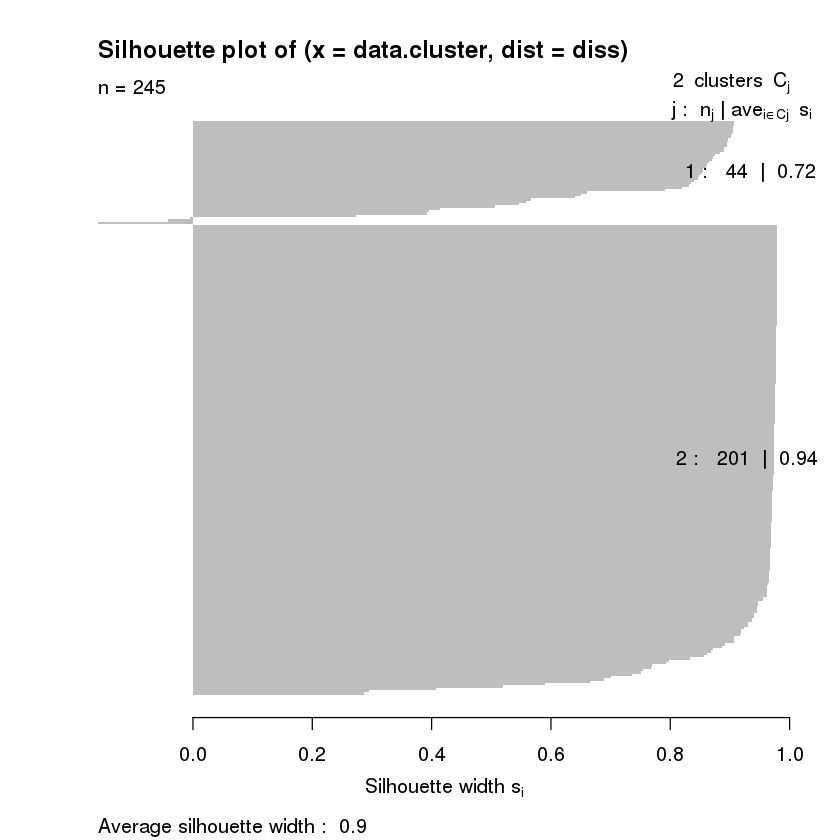

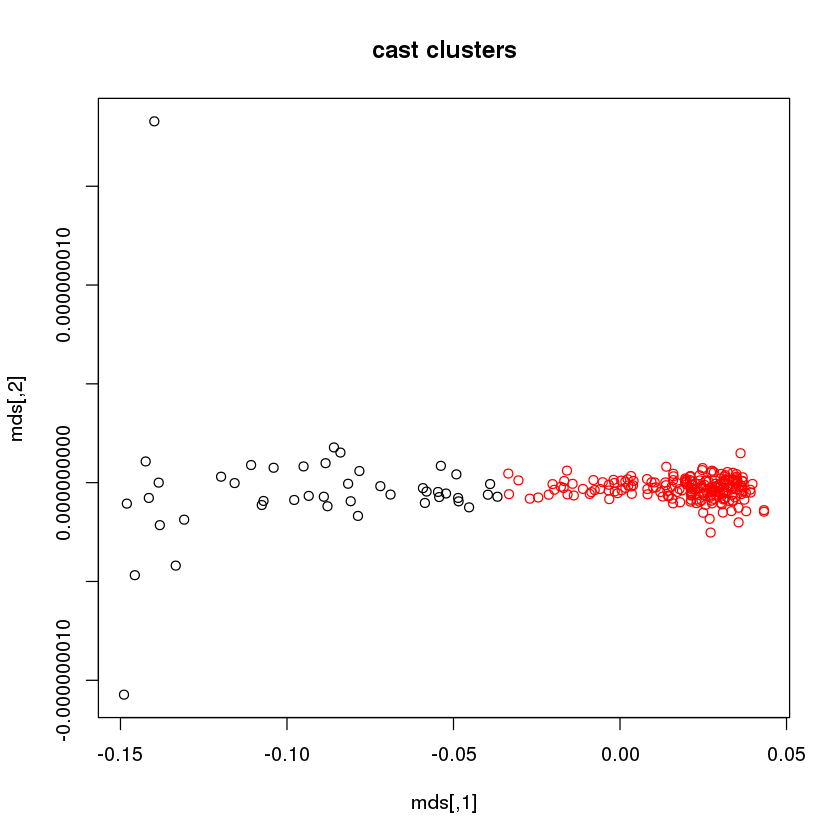

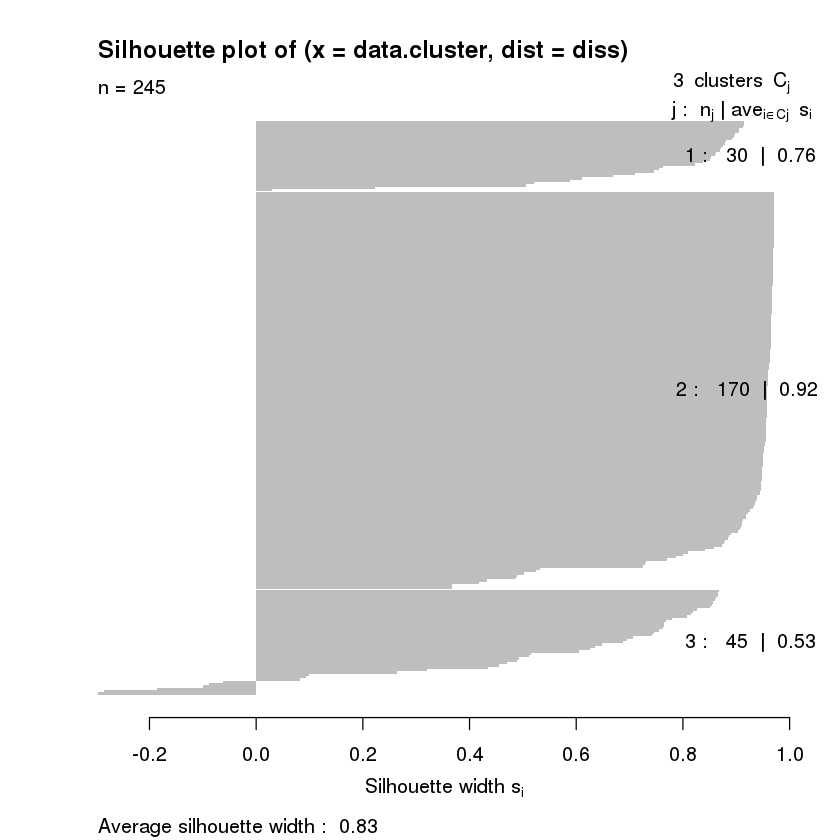

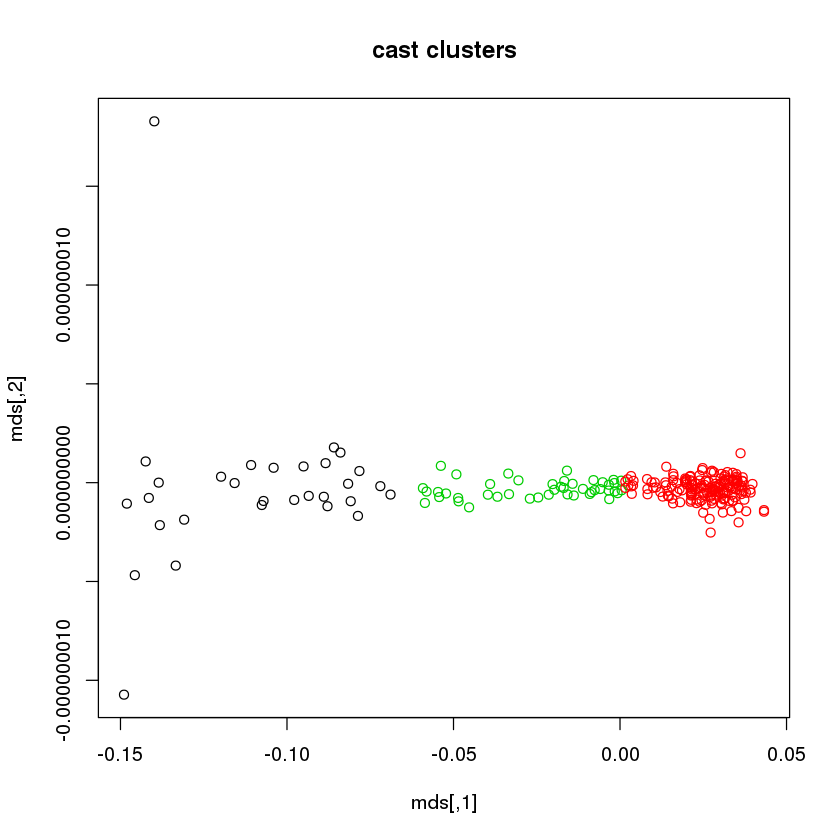

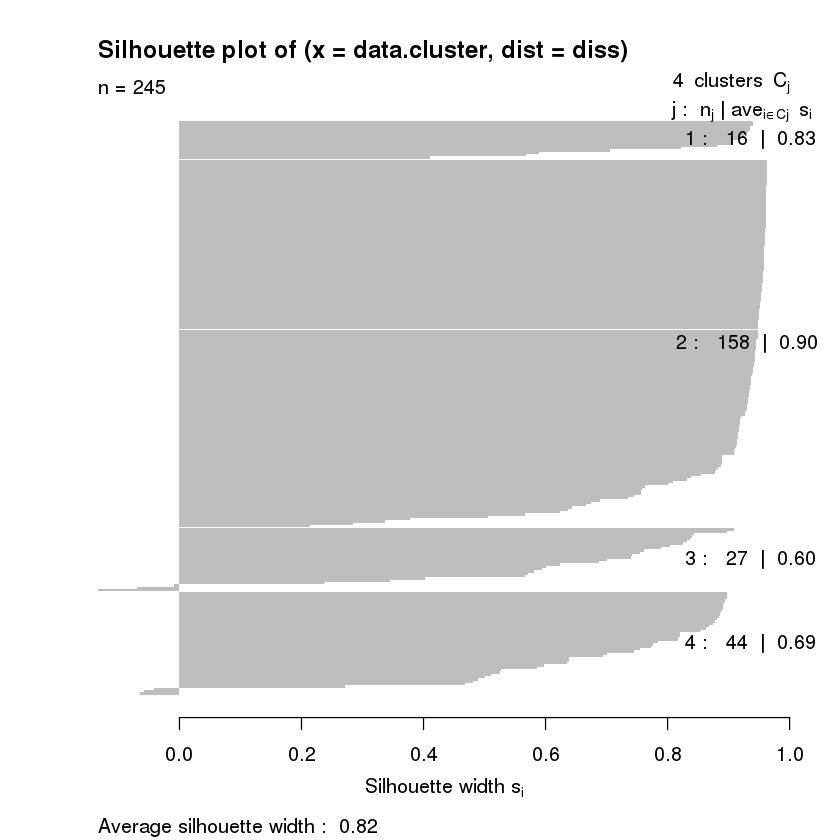

...

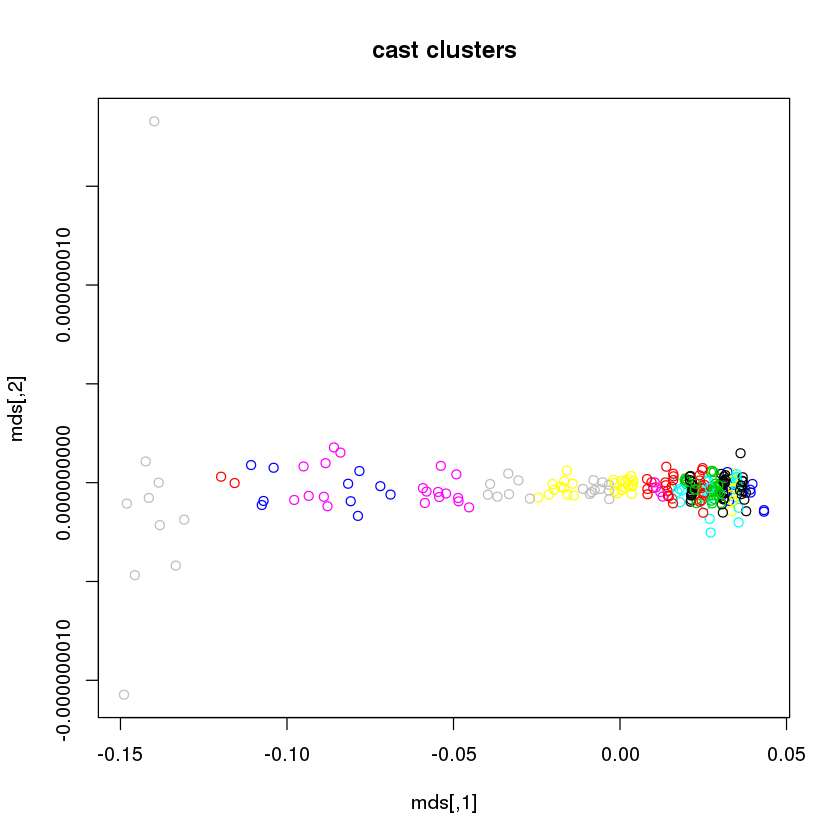

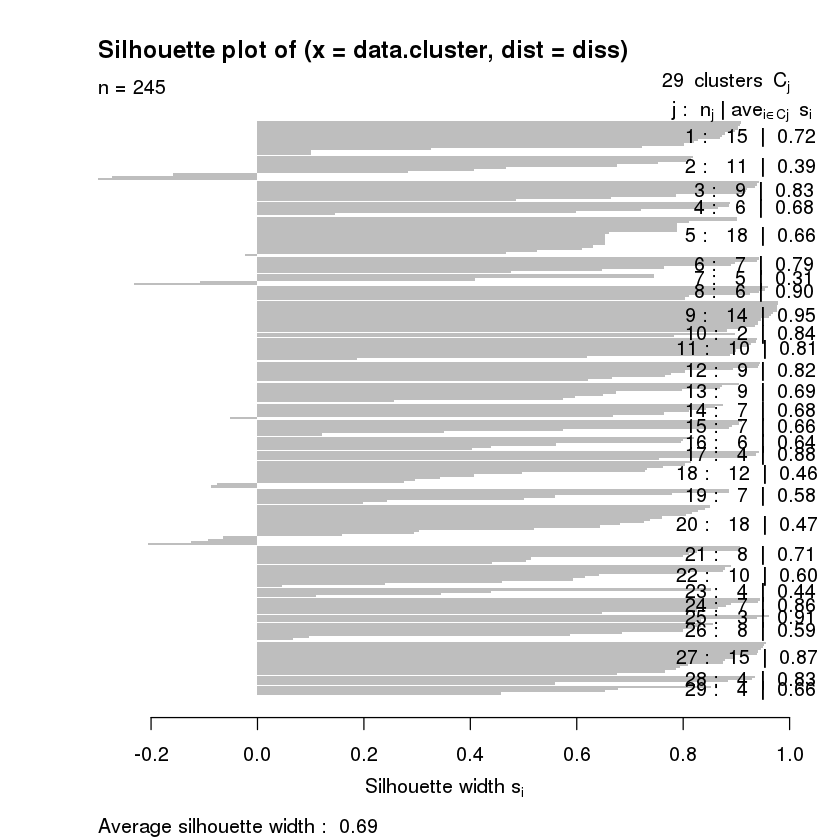

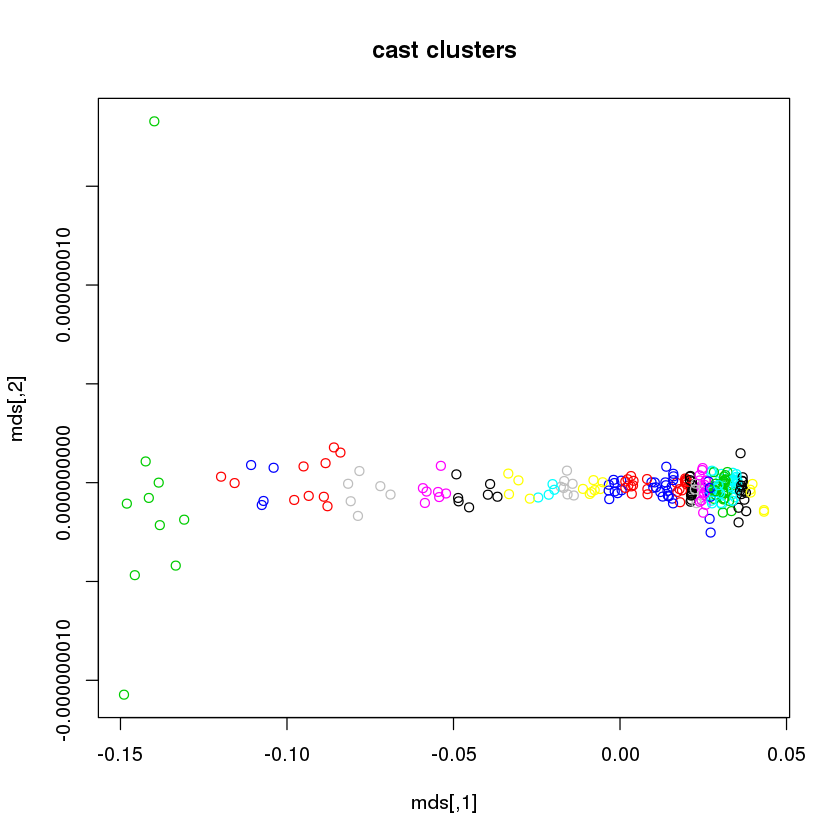

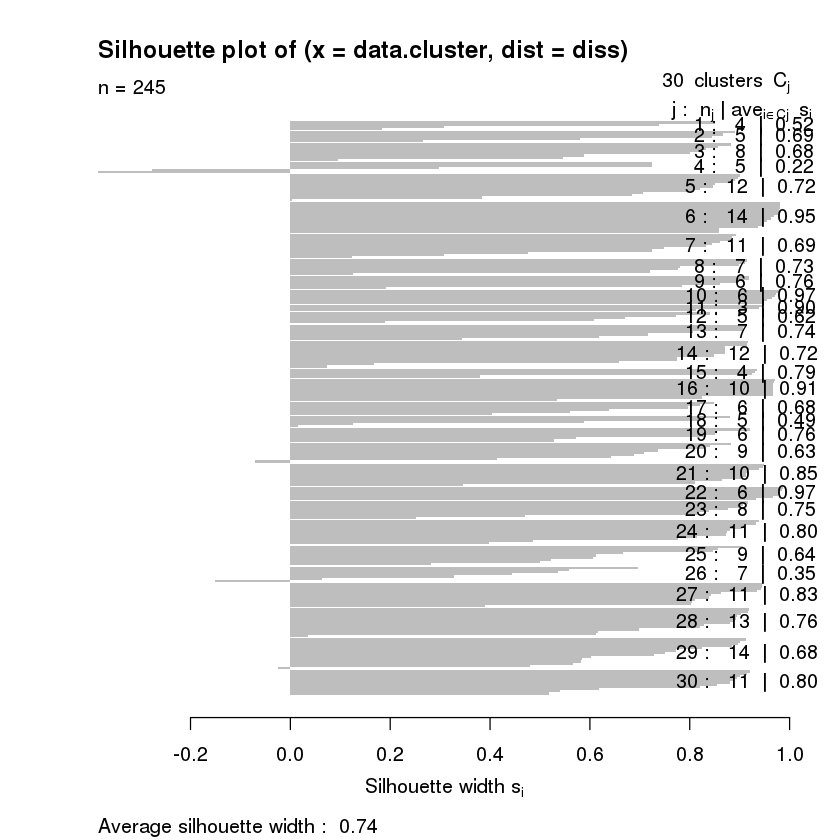

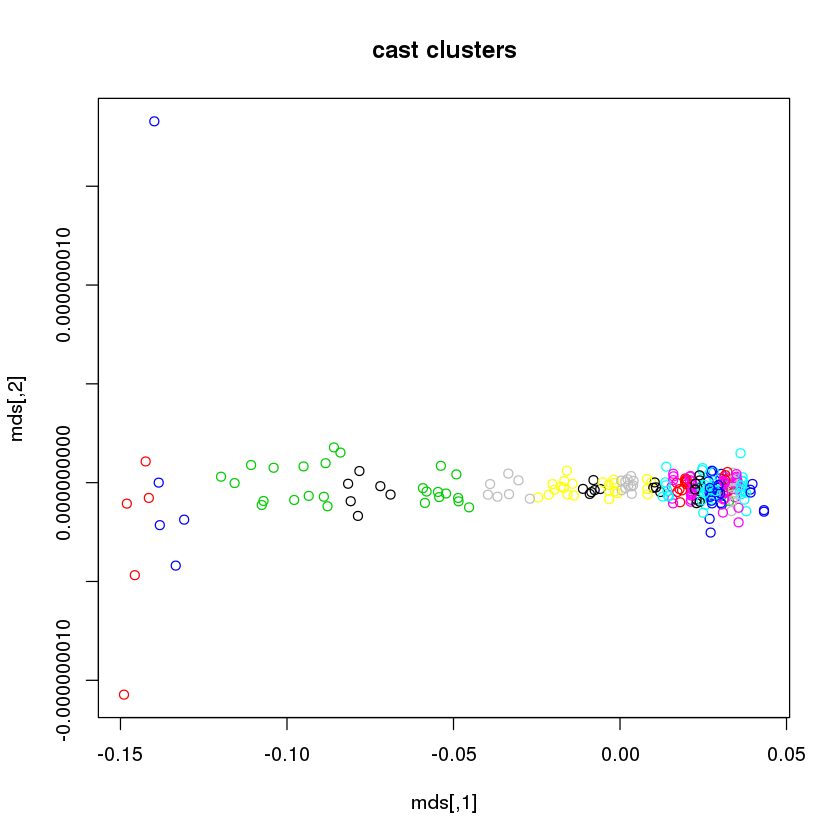

In [286]:

avr.list <- lapply(2:20, function(x) {
        var <- list("mat"=sim.matrix, "num"=x)
        ret <- spectral.clustering.func(var)
        avr <- calc.slihouette.func(ret$mat, ret$cluster$cl)
        cast.cluster.plot.func(ret$mat, ret$cluster)
        return(avr)
    })


In [281]:
avr.data <- do.call(rbind, avr.list)

In [282]:
avr.data

0.9008215
0.8290748
0.8241428
0.7060245
0.7423967
0.671429
0.701036
0.6631049
0.692141
0.6811129
0.7158783


In [211]:
data(spirals)
dim(spirals)
dim(cov(t(spirals)))
head(cov(t(spirals)))
rett <- spectral.clustering.func(cov(t(spirals)))

[1] 300   2

[1] 300 300

1.61907083,0.05212297,0.34812012,0.19465016,-1.05868656,0.33983975,0.25993220,0.25529472,0.23338147,0.21048893,0.19841057,-1.14373513,0.30340345,0.19241877,0.13665366,0.43065658,-1.15273032,0.45859152,0.42246361,0.37188899,0.10441904,0.08917130,-0.94083537,0.03368966,0.01008484,-0.02810639,-0.05355303,-0.32584683,1.57951856,-0.93189871,-0.08679951,1.04943262,-0.12007560,-0.15662983,-0.89642815,-0.19088764,0.75703806,-0.23111683,0.70137434,0.77108806,-0.25546534,-0.29374819,-0.38603941,-0.37682588,-1.16356937,0.26749721,-1.12225941,1.56964530,-0.93145405,-0.39494228,0.52059468,-0.45397775,1.64674018,1.51384393,-0.49852059,-0.52423542,-0.59016002,0.34002338,-0.64087685,0.67751106,0.23031961,-0.40866750,-0.55109808,-0.64771304,-0.20618063,-0.64352407,-0.97879659,-0.11695533,0.14912702,-0.62209749,-0.72304293,-0.29896284,-0.76107941,-0.68006894,-0.78921356,0.90377347,0.28456182,0.43998116,1.45602029,-0.72123557,-1.13722715,-0.80386079,-0.02671027,-0.75641933,-0.15355249,1.51287436,1.57187411,-0.86597846,0.68600653,1.45626745,-0.79041022,1.59530652,0.08564077,-0.71286487,-0.66880874,-0.66099167,0.67825686,-0.73828325,-0.74027395,-0.74840282,-0.67496405,0.61335926,0.15476362,0.91341020,-0.63687810,-0.68818433,-0.09272466,-0.69954431,-0.62646469,-0.48543219,1.36150143,-0.49945068,0.61447559,0.00899837,0.75222820,1.20470671,-0.39785809,-0.37238030,-0.19795045,0.38202075,-0.37610530,0.49185270,0.20100263,1.44882945,-0.30166435,0.78615505,-0.24293206,-1.19537793,1.22203304,-0.20498422,0.76722753,-0.14931545,-0.20359925,-0.15562723,-0.08696173,-0.03317204,0.03748958,-0.70562187,-1.17004516,1.26988839,0.09456296,0.15147548,-1.12753705,0.21973536,0.64954032,0.73486652,-0.85464408,0.27495653,0.35264963,0.40197396,0.52392547,0.47731567,0.50612992,0.58577666,0.64027379,0.70226665,0.77072576,-0.41038156,-0.80758009,-0.97035881,0.21912780,0.84254633,-0.04745991,0.89361716,-0.59617485,0.22842118,0.03213587,0.85475150,0.12361224,0.39994986,-0.71481254,0.82195994,0.94551381,-1.13468080,0.99163024,1.44185853,0.51679945,0.73237753,1.05468497,1.15370253,1.31003938,-0.12496433,-0.33067569,1.01328563,1.10736006,1.00611727,0.65812019,1.40226815,1.15469834,1.13420825,1.10424774,1.21165497,1.26991163,1.18690618,1.08875144,1.13559567,-0.02817569,1.50593310,-1.15874283,0.73400368,1.16361520,0.57054303,1.07277011,1.05213518,0.66766586,1.06842288,0.85384249,0.95226818,0.93315176,0.93992034,0.84101823,0.80279414,-0.01076268,0.74508137,-0.93279624,0.66909781,-0.28989660,0.62608349,0.52452365,0.67417744,0.13095756,0.51578787,0.43971783,0.39213341,0.29400956,-0.66926112,0.56742587,-0.20767538,0.20354178,0.80744791,-1.14822122,0.12813537,0.04996230,-0.04991571,-0.13092934,-0.22411656,-0.67222143,0.50426793,-0.31274164,-0.39983576,-0.47686602,-0.57006028,0.34216991,-0.18986093,0.47025906,-0.67348462,-0.72823160,-0.79772425,-0.89571895,-1.00697697,-1.08748067,-1.01739815,0.09864698,-1.10939647,-1.12097356,-0.45900786,0.04397814,-0.27380350,-0.56925268,-0.50832595,-0.96200875,0.62792488,-1.21215364,-1.32367712,-1.35536385,-1.44455022,1.64078759,-1.42317929,-0.21818924,-1.45893349,-0.78581117,-0.08557226,-1.49879135,-1.56000600,-1.54538980,-1.08148961,-1.56760113,-0.59399902,0.30871441,1.33141893,1.64260646,-1.59784616,-1.56628256,0.62376385,-1.57271519,-0.09377799,-1.60913322,-1.60339330,-1.54181863,-0.45976836,-1.50557711,-0.23584139,-1.49961073,-1.46744151,1.47248723,1.13252127,-1.45996840,-1.38929105,-1.30608603,-1.14226630
0.0521229683,0.0016780018,0.0112070787,0.0062663991,-0.0340824411,0.0109405074,0.0083680328,0.0082187378,0.0075132815,0.0067762987,0.0063874585,-0.0368204212,0.0097675088,0.0061945639,0.0043993098,0.0138641862,-0.0371100046,0.0147634995,0.0136004287,0.0119722730,0.0033615765,0.0028707040,-0.0302884417,0.0010845759,0.0003246628,-0.0009048329,-0.0017240399,-0.0104900317,0.0508496570,-0.0300007425,-0.0027943485,0.0337845277,-0.0038656102,-0.0050424054,-0.0288588338,-0.0061452720,0.0243714298,-0.0074403757,0.0225794400,0.0248237432,-0.0082242306,-0

Warning message:
In sqrt(inv.D): 产生了NaNsWarning message:
In sqrt(inv.D): 产生了NaNs

ERROR: Error in diag(1, n) - sqrt(inv.D) %*% sim.mat %*% sqrt(inv.D): 非整合陈列


ERROR: Error in base::rowSums(x, na.rm = na.rm, dims = dims, ...): 'x' must be an array of at least two dimensions


K-means clustering with 2 clusters of sizes 77, 168

Cluster means:
          [,1]
1 -0.095951706
2 -0.001300819

Clustering vector:
  [1] 1 2 2 2 2 2 2 2 2 2 2 2 2 2 1 2 2 2 2 1 2 2 2 2 2 2 2 2 2 2 2 1 1 2 1 2 2
 [38] 2 2 2 1 2 1 2 1 2 1 1 1 2 2 2 2 2 2 1 2 1 2 2 2 2 2 1 2 2 2 1 2 1 2 1 1 1
 [75] 2 2 1 2 2 2 2 2 2 2 1 1 2 2 2 2 2 2 2 2 1 2 2 2 2 1 2 2 1 2 2 2 2 2 1 2 2
[112] 2 1 2 1 1 2 2 1 1 2 2 2 2 2 2 2 2 2 2 1 2 2 2 1 1 2 1 2 2 2 2 2 2 2 2 2 2
[149] 1 2 2 1 2 2 1 1 1 1 1 2 2 1 2 2 2 2 1 2 1 2 1 2 1 1 2 2 1 2 2 2 1 2 1 2 2
[186] 2 2 1 1 2 2 1 2 1 2 2 2 1 1 2 2 2 2 1 1 2 1 2 2 2 1 2 1 2 1 1 1 2 2 2 1 2
[223] 1 1 1 2 2 2 1 1 2 2 2 2 2 1 2 1 2 2 2 1 1 1 2

Within cluster sum of squares by cluster:
[1] 0.1227285 0.1680690
 (between_SS / total_SS =  61.9 %)

Available components:

[1] "cluster"      "centers"      "totss"        "withinss"     "tot.withinss"
[6] "betweenss"    "size"         "iter"         "ifault"      

In [9]:
calc.slihouette.func <- function(data.mat, data.cluster, lev=2) {
    diss <- daisy(as.matrix(data.mat))
    diss <- diss^lev
    s <- silhouette(data.cluster, diss)
    plot(s)
    avr <- sum(s[,3])/nrow(s)
    return(avr)
}

#calc.slihouette.func(q$vectors[,nrow(sim.matrix)-1], cls$cl)

In [226]:
head(q$vectors[,nrow(sim.matrix)])

[1] -0.01735154 -0.18307086 -0.19217367 -0.18892465 -0.01602519 -0.01589201

In [8]:
cast.cluster.plot.func <- function(data.mat, data.cluster, dist.method="euclidean"){
    euc.dist <- dist(data.mat, method=dist.method)
    mds = cmdscale(euc.dist)
    plot(mds, col=data.cluster$cluster, main="cast clusters")    
}
#cast.cluster.plot.func(q$vectors[,nrow(sim.matrix)-1], cls, dist.method="manhattan")

In [46]:
dim(q$vectors)

[1] 127 127

In [53]:
#kmeans(q$vectors[,125], 2)

K-means clustering with 2 clusters of sizes 1, 126

Cluster means:
  [,1]
1    1
2    0

Clustering vector:
  [1] 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2
 [38] 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2
 [75] 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2
[112] 2 2 2 2 2 2 2 2 2 2 2 2 1 2 2 2

Within cluster sum of squares by cluster:
[1] 0 0
 (between_SS / total_SS = 100.0 %)

Available components:

[1] "cluster"      "centers"      "totss"        "withinss"     "tot.withinss"
[6] "betweenss"    "size"         "iter"         "ifault"      

In [43]:
#displaySpectClust(sim.matrix, d=2, q="samples", keepFirst = FALSE)
#specClust(sim.matrix, method = "symmetric")
#head(sim.matrix)
#sum((is.inf(sim.matrix)))
#specClust(sim.matrix)

ERROR: Error in mydist(data, nn): 外接函数调用时不能有NA/NaN/Inf(arg1)


In [7]:
stat.res.func <- function(data.set, clust) {
     ids <- rownames(data.set)  
     clust.data <- as.data.frame(cbind(ids, clust))
   

     colnames(clust.data) <- c("company_id", "cluster")
     detail.file <- "/data/users/jiancheng.zhai/project/advertiser_cluster/data/finance/detail"
     detail.data <- read.file.func(detail.file)
     colnames(detail.data) <- c("name", "class", "raw_data", "ad_id", "company_id")

     merge.data <- merge(clust.data, detail.data, by="company_id", all.x=T, all.y=F)

     raw.file <- "/data/users/jiancheng.zhai/project/advertiser_cluster/data/finance/pyid_wcos/week_data"
     raw.data <- read.file.func(raw.file)
     colnames(raw.data) <- c("pyid", "company_id")
    
     stat.uv <- tapply(raw.data$pyid, raw.data$company_id, FUN = function(x) length(unique(x)))
     stat.uv.data <- as.data.frame(stat.uv)
     colnames(stat.uv.data) <- c("uv")
     stat.uv.data$company_id <- row.names(stat.uv.data)
     merge.data <- merge(merge.data, stat.uv.data, by="company_id", all.x=T, all.y=F)
     return(merge.data[order(merge.data$cluster), ])
}

In [111]:
calc.within.cluster.MSE <- function(clust){
    
    mse <- sum(clust@withinss)/length(clust@withinss)
    return(mse)
}

In [143]:
help(specc)

specc {kernlab},R Documentation
x,"the matrix of data to be clustered, or a symbolic description of the model to be fit, or a kernel Matrix of class kernelMatrix, or a list of character vectors."
data,an optional data frame containing the variables in the model. By default the variables are taken from the environment which ‘specc’ is called from.
centers,"Either the number of clusters or a set of initial cluster centers. If the first, a random set of rows in the eigenvectors matrix are chosen as the initial centers."
kernel,"the kernel function used in computing the affinity matrix. This parameter can be set to any function, of class kernel, which computes a dot product between two vector arguments. kernlab provides the most popular kernel functions which can be used by setting the kernel parameter to the following strings: rbfdot Radial Basis kernel function ""Gaussian"" polydot Polynomial kernel function vanilladot Linear kernel function tanhdot Hyperbolic tangent kernel function laplacedot Laplacian kernel function besseldot Bessel kernel function anovadot ANOVA RBF kernel function splinedot Spline kernel stringdot String kernel The kernel parameter can also be set to a user defined function of class kernel by passing the function name as an argument."
kpar,"a character string or the list of hyper-parameters (kernel parameters). The default character string ""automatic"" uses a heuristic to determine a suitable value for the width parameter of the RBF kernel. The second option ""local"" (local scaling) uses a more advanced heuristic and sets a width parameter for every point in the data set. This is particularly useful when the data incorporates multiple scales. A list can also be used containing the parameters to be used with the kernel function. Valid parameters for existing kernels are : sigma inverse kernel width for the Radial Basis kernel function ""rbfdot"" and the Laplacian kernel ""laplacedot"". degree, scale, offset for the Polynomial kernel ""polydot"" scale, offset for the Hyperbolic tangent kernel function ""tanhdot"" sigma, order, degree for the Bessel kernel ""besseldot"". sigma, degree for the ANOVA kernel ""anovadot"". length, lambda, normalized for the ""stringdot"" kernel where length is the length of the strings considered, lambda the decay factor and normalized a logical parameter determining if the kernel evaluations should be normalized. Hyper-parameters for user defined kernels can be passed through the kpar parameter as well."
nystrom.red,"use nystrom method to calculate eigenvectors. When TRUE a sample of the dataset is used to calculate the eigenvalues, thus only a n x m matrix where n the sample size is stored in memory (default: FALSE"
nystrom.sample,number of data points to use for estimating the eigenvalues when using the nystrom method. (default : dim(x)[1]/6)
mod.sample,proportion of data to use when estimating sigma (default: 0.75)
iterations,the maximum number of iterations allowed.
na.action,the action to perform on NA


In [149]:
#data(spirals)
#sc <- specc(spirals, centers=2)
#plot(spirals, col=sc)
#head()
#specc

function (x, ...) 
standardGeneric("specc")
<environment: 0x770ac88>
attr(,"generic")
[1] "specc"
attr(,"generic")attr(,"package")
[1] "kernlab"
attr(,"package")
[1] "kernlab"
attr(,"group")
list()
attr(,"valueClass")
character(0)
attr(,"signature")
[1] "x"
attr(,"default")
`\001NULL\001`
attr(,"skeleton")
(function (x, ...) 
stop("invalid call in method dispatch to 'specc' (no default method)", 
    domain = NA))(x, ...)
attr(,"class")
[1] "standardGeneric"
attr(,"class")attr(,"package")
[1] "methods"

In [141]:
#clust <- specc(sim.matrix, centers=100)
#plot(silhouette(clust))
#head(sim.matrix)
#class(clust@.Data)
#calc.within.cluster.MSE(clust)
#sum(clust@withinss)


[1] 52.7843

In [133]:
clust

Spectral Clustering object of class "specc" 

 Cluster memberships: 
 
91 37 68 37 5 67 73 51 42 55 5 5 86 38 19 8 73 85 84 77 40 23 99 25 54 96 69 51 34 92 58 88 83 99 44 25 68 81 40 65 13 9 41 51 63 79 56 16 4 87 87 61 26 35 53 5 74 63 33 62 78 66 40 31 93 11 78 22 81 96 54 50 31 63 90 40 52 85 75 6 71 39 54 94 33 46 97 72 87 51 9 8 10 6 88 60 10 64 54 53 56 47 13 52 97 54 89 100 16 92 23 5 63 3 91 88 54 30 27 74 95 65 57 11 36 54 15 53 68 67 74 40 55 58 1 41 28 22 17 71 86 45 53 35 70 40 27 76 14 40 93 80 93 51 32 2 69 31 1 54 82 98 20 93 29 3 59 54 19 54 41 47 1 69 56 54 88 5 21 56 70 47 76 18 79 51 54 49 31 47 40 12 15 31 47 54 54 63 53 54 48 71 61 88 40 3 77 70 30 93 1 100 31 6 98 2 77 54 48 55 46 89 24 32 76 96 53 56 51 76 53 71 94 17 93 1 70 94 38 7 96 90 43 59 47 
 
Gaussian Radial Basis kernel function. 
 Hyperparameter : sigma =  42.2388624567479 

Centers:  
             [,1]        [,2]       [,3]        [,4]        [,5]        [,6]
  [1,] 0.01270000 0.000000000 0.00550000

In [124]:
detail.data <- stat.res.func(sim.matrix, clust@.Data)

In [402]:
url.sim.file <- "../tools/wcos_general/url_sim"
url.sim.data <- read.file.func(url.sim.file)


pyid.sim.file <- "../tools/wcos_general/pyid_sim"
pyid.sim.data <- read.file.func(pyid.sim.file)


url.sim.data <- trim.sim.data.func(url.sim.data)
pyid.sim.data <- trim.sim.data.func(pyid.sim.data)

url.sim.matrix <- as.matrix(url.sim.data)
pyid.sim.matrix <- as.matrix(pyid.sim.data)



In [403]:
dim(url.sim.matrix)
head(url.sim.matrix)

[1] 245 245

,5662,5634,5623,5606,5592,5532,5529,5527,5495,5485,5481,5463,5460,5447,5438,5418,5403,5384,5372,5347,5340,5320,5316,5311,5292,5270,5263,5258,5253,5233,5231,5198,5190,5165,5155,5119,5113,5086,5061,5047,5030,5000,4998,4992,4991,4986,4975,4974,4946,4911,4883,4878,4852,4828,4754,4735,4614,4570,4561,4560,4554,4522,4477,4361,4286,4271,4246,4240,4209,4206,4195,4120,4105,4101,4099,4095,4087,4073,4069,4067,4046,4038,4002,3998,3986,3954,3951,3950,3929,3924,3906,3903,3895,3880,3849,3843,3825,3820,3812,3811,3790,3766,3764,3747,3744,3743,3741,3731,3719,3718,3694,3676,3607,3603,3598,3584,3558,3547,3546,3543,3498,3448,3442,3435,3426,3410,3405,3399,3398,3396,3387,3372,3353,3350,3344,3323,3299,3281,3264,3249,3222,3215,3184,3170,3166,3145,3122,3119,3109,3107,3106,3023,3021,3003,2999,2936,2922,2915,2910,2897,2893,2892,2862,2856,2841,2817,2814,2811,2799,2776,2772,2763,2754,2740,2715,2706,2642,2618,2600,2546,2543,2536,2530,2529,2527,2520,2487,2482,2469,2455,2447,2435,2393,2392,2382,2377,2327,2320,2272,2270,2257,2248,2219,2211,2150,2128,2080,2065,2025,1953,1918,1910,1899,1877,1876,1845,1828,1822,1820,1800,1791,1783,1774,1740,1716,1705,1649,1572,1570,1550,1514,1495,1423,1413,1392,1348,1341,1286,1232,1209,1200,1178,1172,1127,1069
5662,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0621,0.0000,0.0000,0.0000,0.0000,0.0417,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0249,0.0000,0.0000,0.0000,0.0000,0.0000,0.0490,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0473,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0454,0.0000,0.0000,0.0327,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0570,0.0000,0.0288,0.0000,0.0000,0.0421,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0426,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0252,0.0000,0.0000,0.0000,0.0232,0.0000,0.0000,0.0519,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0560,0.0000,0.0000,0.0311,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0333,0.0000,0.0000,0.0387,0.0000,0.0000,0.0352,0.0000,0.0000,0.0349,0.0635,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0526,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0273,0.0000,0.0000,0.0000,0.0584,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0380,0.0000,0.0000,0.0000,0.0000,0.0000,0.0380,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0285,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0272,0.0000,0.0000,0.0240,0.0540,0.0000
5634,0.0000,0.0000,0.3375,0.3007,0.0000,0.0000,0.2267,0.0000,0.0000,0.2272,0.0000,0.0000,0.2570,0.2013,0.0000,0.1829,0.2409,0.2290,0.2891,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.2857,0.0000,0.0000,0.0000,0.0000,0.3412,0.0000,0.2611,0.3252,0.2074,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.2000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.1859,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.2301,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.2032,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.2271,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.2475,0.0000,0.1909,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.2351,0.0000,0.0000,0.0000,0.2052,0.2129,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000

In [10]:
try.cluster.num.func <- function(sim.matrix){
    cluster.num <- 2:10
    
    avr.list <- lapply(cluster.num, function(x) {
        var <- list("mat"=sim.matrix, "num"=x)
        ret <- spectral.clustering.func(var)
        avr <- calc.slihouette.func(ret$mat, ret$cluster$cl)
        cast.cluster.plot.func(ret$mat, ret$cluster)
        return(avr)
    }) 
    avr.data <- do.call(rbind, avr.list)
    plot(cluster.num, avr.data, 
         type="o", 
         xlab="Number of Cluster", 
         ylab="Silhouette Coefficient")
}

#try.cluster.num.func(url.sim.matrix)

In [344]:
var <- list("mat"=url.sim.matrix, "num"=9)
ret <- spectral.clustering.func(var)
str(ret)
detail.data <- stat.res.func(url.sim.matrix, ret$cluster$cl)

List of 2
 $ mat    : num [1:33] -0.207 -0.217 -0.221 -0.2 -0.181 ...
 $ cluster:List of 9
  ..$ cluster     : int [1:33] 8 1 1 7 9 6 6 5 3 9 ...
  ..$ centers     : num [1:9, 1] -0.2189 -0.1902 -0.0608 -0.1133 -0.1939 ...
  .. ..- attr(*, "dimnames")=List of 2
  .. .. ..$ : chr [1:9] "1" "2" "3" "4" ...
  .. .. ..$ : NULL
  ..$ totss       : num 0.0708
  ..$ withinss    : num [1:9] 0.0000115 0 0.0007721 0.0004718 0.0000019 ...
  ..$ tot.withinss: num 0.0015
  ..$ betweenss   : num 0.0693
  ..$ size        : int [1:9] 3 1 3 4 3 6 3 5 5
  ..$ iter        : int 3
  ..$ ifault      : int 0
  ..- attr(*, "class")= chr "kmeans"


In [345]:
detail.data

,company_id,cluster,name,class,raw_data,ad_id
17,3222,1,胖胖猪信息咨询服务（北京）有限公司,P2P平台,金融类/P2P平台,9207
35,5316,1,北京宝瑞通典当行有限责任公司,其他金融类,金融类/其他金融类,12183
36,5495,1,深圳前海盈世纪金融服务有限公司,股票基金,金融类/证券/股票基金,12423
15,3170,2,武汉盛世乐居,P2P平台,金融类/P2P平台,9101
1,1178,3,成都易贷网络科技有限公司,P2P投资理财,金融类/P2P平台/P2P投资理财,4941
26,4101,3,宁波合众芸创财富投资管理有限公司,P2P平台,金融类/P2P平台,10469
29,4561,3,凯福德金业（香港）有限公司,其他金融类,金融类/其他金融类,10355
7,1845,4,投哪网,P2P平台,金融类/P2P平台,8852
8,1845,4,深圳投哪金融服务有限公司,P2P贷款,金融类/P2P平台/P2P贷款,7020
12,2772,4,宜信投米,P2P投资理财,金融类/P2P平台/P2P投资理财,8441


In [314]:
adv.file <- "/data/users/jiancheng.zhai/project/advertiser_cluster/data/finance/url_wcos/2015-12-25.adv"
adv.data <- read.file.func(adv.file)

In [318]:
adv.data.stat <- as.data.frame(table(adv.data$V1))


In [333]:
adv.data.stat <- adv.data.stat[order(adv.data.stat$Freq,  decreasing=T), ]
dim(adv.data.stat)
dim(adv.data.stat[adv.data.stat$Freq>500, ])
#sub.d <- adv.data.stat[adv.data.stat$Freq>500, ]

a.d <- adv.data[adv.data$V2=="3249", ]
b.d <- adv.data[adv.data$V2=="1178", ]

a.d <- as.data.frame(table(a.d$V1))
b.d <- as.data.frame(table(b.d$V1))

a.d <- a.d[a.d$Freq>100, ]
b.d <- b.d[b.d$Freq>100, ]


#plot(adv.data.stat$Freq)

[1] 1874    2

[1] 290   2

In [334]:
b.d 
a.d

,Var1,Freq
16,bazhong.edai.com,385
21,bj.edai.com,4272
30,cc.edai.com,111
31,cd.edai.com,6115
43,cq.edai.com,858
44,cs.edai.com,324
45,cz.edai.com,121
50,dg.edai.com,307
52,dl.edai.com,129
58,edai.com,38802


,Var1,Freq
4,localhost,303
7,zzcaifu.com,3440


In [346]:
comp.sim.file <- "/data/users/jiancheng.zhai/project/advertiser_cluster/data/finance/comp_weighted_mat"
comp.sim.data <- read.file.func(comp.sim.file)

In [348]:
head(comp.sim.data)

V1 V2 V3 V4 V5 V6 V7 V8 V9 V10 V11 V12 V13 V14 V15 V16 V17 V18 V19 V20 V21
1 5030  0  0  0  0  0  0  0  0   0   0   0   0   0   0   0   0   0   0   0   0
2 2784  0  0  0  0  0  0  0  0   0   0   0   0   0   0   0   0   0   0   0   0
3 2548  0  0  0  0  0  0  0  0   0   0   0   0   0   0   0   0   0   0   0   0
4 2527  0  0  0  0  0  0  0  0   0   0   0   0   0   0   0   0   0   0   0   0
5 3514  0  0  0  0  0  0  0  0   0   0   0   0   0   0   0   0   0   0   0   0
6 1674  0  0  0  0  0  0  0  0   0   0   0   0   0   0   0   0   0   0   0   0
  V22 V23 V24 V25 V26 V27 V28 V29 V30 V31 V32 V33 V34 V35 V36 V37 V38 V39 V40
1   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0
2   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0
3   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0
4   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0
5   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0
6   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0
  V41 V42 V43 V44 V45 V46 V47 V48 V49 V50 V51 V52 V53 V54 V55             V56
1   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0 0.0000000000000
2   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0 0.0000000000000
3   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0 0.0000000000000
4   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0 0.0000001006924
5   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0 0.0000000000000
6   0   0   0   0   0   0   0   0   0   0   0   0   0   0   0 0.0000000000000
  V57               V58 V59 V60 V61 V62 V63 V64 V65 V66 V67 V68 V69 V70 V71 V72
1   0 0.000000000000000   0   0   0   0   0   0   0   0   0   0   0   0   0   0
2   0 0.000000000000000   0   0   0   0   0   0   0   0   0   0   0   0   0   0
3   0 0.000000000000000   0   0   0   0   0   0   0   0   0   0   0   0   0   0
4   0 0.000000003800195   0   0   0   0   0   0   0   0   0   0   0   0   0   0
5   0 0.000000000000000   0   0   0   0   0   0   0   0   0   0   0   0   0   0
6   0 0.000000000000000   0   0   0   0   0   0   0   0   0   0   0   0   0   0
  V73 V74 V75 V76 V77 V78 V79              V80 V81 V82 V83 V84 V85 V86 V87 V88
1   0   0   0   0   0   0   0 0.00000000000000   0   0   0   0   0   0   0   0
2   0   0   0   0   0   0   0 0.00000000000000   0   0   0   0   0   0   0   0
3   0   0   0   0   0   0   0 0.00000000000000   0   0   0   0   0   0   0   0
4   0   0   0   0   0   0   0 0.00000002344729   0   0   0   0   0   0   0   0
5   0   0   0   0   0   0   0 0.00000000000000   0   0   0   0   0   0   0   0
6   0   0   0   0   0   0   0 0.00000000000000   0   0   0   0   0   0   0   0
  V89 V90 V91 V92 V93 V94 V95 V96 V97 V98 V99 V100 V101 V102 V103 V104 V105
1   0   0   0   0   0   0   0   0   0   0   0    0    0    0    0    0    0
2   0   0   0   0   0   0   0   0   0   0   0    0    0    0    0    0    0
3   0   0   0   0   0   0   0   0   0   0   0    0    0    0    0    0    0
4   0   0   0   0   0   0   0   0   0   0   0    0    0    0    0    0    0
5   0   0   0   0   0   0   0   0   0   0   0    0    0    0    0    0    0
6   0   0   0   0   0   0   0   0   0   0   0    0    0    0    0    0    0
  V106 V107 V108 V109 V110 V111 V112 V113 V114 V115 V116 V117 V118 V119 V120
1    0    0    0    0    0    0    0    0    0    0    0    0    0    0    0
2    0    0    0    0    0    0    0    0    0    0    0    0    0    0    0
3    0    0    0    0    0    0    0    0    0    0    0    0    0    0    0
4    0    0    0    0    0    0    0    0    0    0    0    0    0    0    0
5    0    0    0    0    0    0    0    0    0    0    0    0    0    0    0
6    0    0    0    0    0    0    0    0    0    0    0    0    0    0    0
  V121 V122 V123 V124 V125 V126 V127 V128 V129 V130 V131 V132            V133
1    0    0    0    0    0    0    0    0    0    0    0    0 0.0000000000000
2    0    0    0   

In [350]:
rownames(comp.sim.data) <- comp.sim.data$V1
comp.sim.data$V1 <- NULL
scaled.comp.sim.data <- scale(comp.sim.data)

In [359]:
intern <- clValid(comp.sim.data,2:10, clMethods=c("hierarchical", "kmeans", "pam"), validation="internal")

In [360]:
summary(intern)
#sum(is.na(scaled.comp.sim.data))
#sum(is.nan(scaled.comp.sim.data))
#sum(is.infinite(scaled.comp.sim.data))
#head(scaled.comp.sim.data)


Clustering Methods:
 hierarchical kmeans pam 

Cluster sizes:
 2 3 4 5 6 7 8 9 10 

Validation Measures:
                                 2       3       4       5       6       7       8       9      10
                                                                                                  
hierarchical Connectivity   2.9290  5.8579  8.7869 11.7159 14.6448 17.5738 20.5028 23.4317 26.3607
             Dunn           0.8451  1.0291  0.8218  0.7769  0.7672  0.7452  0.6771  0.6952  0.7203
             Silhouette     0.8646  0.8605  0.8147  0.7954  0.7848  0.7745  0.7668  0.7653  0.7644
kmeans       Connectivity   2.9290  5.8579  8.7869 11.7159 14.6448 17.5738 20.5028 23.4317 26.3607
             Dunn           0.8451  1.0291  0.8218  0.7769  0.7672  0.7452  0.6771  0.6952  0.7203
             Silhouette     0.8646  0.8605  0.8147  0.7954  0.7848  0.7745  0.7668  0.7653  0.7644
pam          Connectivity   2.9290  5.8579  8.7869 11.7159 14.6448 17.5738 20.5028 23.4317 26.3607
   

In [364]:
hc <- clusters(intern, "hierarchical")



In [368]:
two <- cutree(hc, 3)

In [11]:
adv.file <- "/data/users/jiancheng.zhai/project/advertiser_cluster/data/finance/week_data"
adv.data <- read.file.func(adv.file)

In [372]:
head(adv.data,n=100)

,V1,V2,V3,V4,V5
1,1021,General,jince.com,EA366WABsmD,95
2,1021,General,jince.com,FC87AO0Qckr5,394
3,1069,General,qbao.com,FBA02ICFcqKf,42
4,1127,General,old.jinshangdai.com,FB59dD0Lu3D,1
5,1127,General,old.jinshangdai.com,FCILw9AocdYU,112
6,1127,General,old.jinshangdai.com,EABG9K4QahJR,233
7,1127,General,old.jinshangdai.com,F4MN_MEiagTs,126
8,1127,General,old.jinshangdai.com,FB59dD0Lu3D,1
9,1127,General,old.jinshangdai.com,FCILw9AocdYU,112
10,1127,General,old.jinshangdai.com,F6NKAr0kacxG,2


In [12]:
adv.d <- as.data.frame(table(adv.data$V1))

#hist(table(adv.data$V1))
#adv.d <- adv.d[adv.d$Freq < 20000, ]
#hist(adv.d$Freq)

In [13]:
colnames(adv.d) <- c("company_id", "UV")

In [394]:
  #ids <- rownames(data.set)  
  #clust.data <- as.data.frame(cbind(ids, clust))
  #colnames(clust.data) <- c("company_id", "cluster")
     detail.file <- "../data/finance/detail"
     detail.data <- read.file.func(detail.file)
     colnames(detail.data) <- c("name", "class", "raw_data", "ad_id", "company_id")

     merge.data <- merge(adv.d, detail.data, by="company_id", all.x=T, all.y=F)





In [401]:
merge.data <- merge.data[order(merge.data$UV), ]
merge.data$cluster <- 1
merge.data[merge.data$UV>2000 & merge.data$UV<=20000, ]$cluster <- 2
merge.data[merge.data$UV>20000 & merge.data$UV<=200000, ]$cluster <- 3
merge.data[merge.data$UV>200000 & merge.data$UV<=700000, ]$cluster <- 4
merge.data[merge.data$UV>700000, ]$cluster <- 5
merge.data

,company_id,UV,name,class,raw_data,ad_id,cluster
23,1459,1,北京易通贷网络科技有限公司,P2P平台,金融类/P2P平台,5888,1
48,1814,1,深圳市日益创投电子商务有限公司,P2P投资理财,金融类/P2P平台/P2P投资理财,6924,1
59,1868,1,广州市穗金所信息技术有限公司,P2P平台,金融类/P2P平台,7062,1
63,1881,1,深圳市国湘实业发展有限公司,P2P平台,金融类/P2P平台,7101,1
73,1974,1,阳光易贷,P2P平台,金融类/P2P平台,7302,1
79,2030,1,深圳第一光年金融控股有限公司,P2P贷款,金融类/P2P平台/P2P贷款,7418,1
80,2061,1,秦皇岛帮友贷投资咨询有限公司,P2P投资理财,金融类/P2P平台/P2P投资理财,7491,1
111,2359,1,福建财佰通智能科技有限公司,P2P平台,金融类/P2P平台,7930,1
122,2430,1,深圳安投惠融互联网金融服务有限公司,P2P投资理财,金融类/P2P平台/P2P投资理财,8055,1
128,2480,1,佰仕乐投（北京）信息技术有限公司,P2P投资理财,金融类/P2P平台/P2P投资理财,8126,1


In [10]:
sim.matrix.file <- "../tools/wcos_general/url_sim_matrix"
sim.matrix.data <- read.file.func(sim.matrix.file)

In [405]:
head(sim.matrix.data)


,V1,V2,V3,V4,V5,V6,V7,V8,V9,V10,V11,V12,V13,V14,V15,V16,V17,V18,V19,V20,V21,V22,V23,V24,V25,V26,V27,V28,V29,V30,V31,V32,V33,V34,V35,V36,V37,V38,V39,V40,V41,V42,V43,V44,V45,V46,V47,V48,V49,V50,V51,V52,V53,V54,V55,V56,V57,V58,V59,V60,V61,V62,V63,V64,V65,V66,V67,V68,V69,V70,V71,V72,V73,V74,V75,V76,V77,V78,V79,V80,V81,V82,V83,V84,V85,V86,V87,V88,V89,V90,V91,V92,V93,V94,V95,V96,V97,V98,V99,V100,V101,V102,V103,V104,V105,V106,V107,V108,V109,V110,V111,V112,V113,V114,V115,V116,V117,V118,V119,V120,V121,V122,V123,V124,V125,V126,V127,V128,V129,V130,V131,V132,V133,V134,V135,V136,V137,V138,V139,V140,V141,V142,V143,V144,V145,V146,V147,V148,V149,V150,V151,V152,V153,V154,V155,V156,V157,V158,V159,V160,V161,V162,V163,V164,V165,V166,V167,V168,V169,V170,V171,V172,V173,V174,V175,V176,V177,V178,V179,V180,V181,V182,V183,V184,V185,V186,V187,V188,V189,V190,V191,V192,V193,V194,V195,V196,V197,V198,V199,V200,V201,V202,V203,V204,V205,V206,V207,V208,V209,V210,V211,V212,V213,V214,V215,V216,V217,V218,V219,V220,V221,V222,V223,V224,V225,V226,V227,V228,V229,V230,V231,V232,V233,V234,V235,V236,V237,V238,V239,V240,V241,V242,V243,V244,V245,V246,V247,V248,V249,V250,V251,V252,V253,V254,V255,V256,V257,V258,V259,V260,V261,V262,V263,V264,V265,V266,V267,V268,V269,V270,V271,V272,V273,V274,V275,V276,V277,V278,V279,V280,V281,V282,V283,V284,V285,V286,V287,V288,V289,V290,V291,V292,V293,V294,V295,V296,V297,V298,V299,V300,V301,V302,V303,V304,V305,V306,V307,V308,V309,V310,V311,V312,V313,V314,V315,V316,V317,V318,V319,V320,V321,V322,V323,V324,V325,V326,V327,V328,V329,V330,V331,V332,V333,V334,V335,V336,V337,V338,V339,V340,V341,V342,V343,V344,V345,V346,V347,V348,V349,V350,V351,V352,V353,V354,V355,V356,V357,V358,V359,V360,V361,V362,V363,V364,V365,V366,V367,V368,V369,V370,V371,V372,V373,V374,V375,V376,V377,V378,V379,V380,V381,V382,V383,V384,V385,V386,V387,V388,V389,V390,V391,V392,V393,V394,V395,V396,V397,V398,V399,V400,V401,V402,V403,V404,V405,V406,V407,V408,V409,V410,V411,V412,V413,V414,V415,V416,V417,V418,V419,V420,V421,V422,V423,V424,V425,V426,V427,V428,V429,V430,V431,V432,V433,V434,V435,V436,V437,V438,V439,V440,V441,V442,V443,V444,V445,V446,V447,V448,V449,V450,V451,V452,V453,V454,V455,V456,V457,V458,V459,V460,V461,V462,V463,V464,V465,V466,V467,V468,V469,V470,V471,V472,V473,V474,V475,V476,V477,V478,V479,V480,V481,V482,V483,V484,V485,V486,V487,V488,V489,V490,V491,V492,V493,V494,V495,V496,V497,V498,V499,V500,V501,V502,V503,V504,V505,V506,V507,V508,V509,V510,V511,V512,V513,V514,V515,V516,V517,V518,V519,V520,V521,V522,V523,V524,V525,V526,V527,V528,V529,V530,V531,V532,V533,V534,V535,V536,V537,V538,V539,V540,V541,V542,V543,V544,V545,V546,V547,V548,V549,V550,V551,V552,V553,V554,V555,V556,V557,V558,V559,V560,V561,V562,V563,V564,V565,V566,V567,V568,V569,V570,V571,V572,V573,V574,V575,V576,V577,V578,V579,V580,V581,V582,V583,V584,V585,V586,V587,V588,V589,V590,V591,V592,V593,V594,V595,V596,V597,V598,V599,V600,V601,V602,V603,V604,V605,V606,V607,V608,V609,V610,V611,V612,V613,V614,V615,V616,V617,V618,V619,V620,V621,V622,V623,V624,V625,V626,V627,V628,V629,V630,V631,V632,V633,V634,V635,V636,V637,V638,V639,V640,V641,V642,V643,V644,V645,V646,V647,V648,V649,V650,V651,V652,V653,V654,V655,V656,V657,V658,V659,V660,V661,V662,V663,V664,V665,V666,V667,V668,V669,V670,V671,V672,V673,V674,V675,V676,V677,V678,V679,V680,V681,V682,V683,V684,V685,V686,V687,V688,V689,V690,V691,V692,V693,V694,V695,V696,V697,V698,V699,V700,V701,V702,V703,V704,V705,V706,V707,V708,V709,V710,V711,V712,V713,V714,V715,V716,V717,V718,V719,V720,V721,V722,V723,V724,V725,V726,V727,V728,V729,V730,V731,V732,V733,V734,V735,V736,V737,V738,V739,V740,V741,V742,V743,V744,V745,V746,V747,V748,V749,V750,V751,V752,V753,V754,V755,V756,V757,V758,V759,V760,V761,V762,V763,V764,V765,V766,V767,V768,V769,V770,V771,V772,V773,V774,V775,V776,V777,V778,V779,V780,V781,V782,V783,V784,V785,V786,V787,V788,V789,V790,V791,V792,V793,V794,V795,V796,V797,V798,V799,V800,V801,V802,V803,V804,V805,V806,V807,V808,V809,V810,V811,V812,V813,V814,V815,V816,V817,V818,V819,V820,V821,V8

In [15]:
colnames(adv.data) <- c("comp_id", "device", "url", "pyid", "freq")
head(adv.data)


,comp_id,device,url,pyid,freq
1,1021,General,jince.com,EA366WABsmD,95
2,1021,General,jince.com,FC87AO0Qckr5,394
3,1069,General,qbao.com,FBA02ICFcqKf,42
4,1127,General,old.jinshangdai.com,FB59dD0Lu3D,1
5,1127,General,old.jinshangdai.com,FCILw9AocdYU,112
6,1127,General,old.jinshangdai.com,EABG9K4QahJR,233


In [16]:
sum.freq.by.comp <- tapply(adv.data$freq, adv.data$comp_id, sum)

In [17]:
sum.freq.by.comp.url <- tapply(adv.data$freq, list(adv.data$comp_id, adv.data$url), sum)

In [412]:
head(sum.freq.by.comp.url)

007om.com 007总管.com 00sy.com 027art.com 0335taozhu.com 05532.com
897    NA        NA          NA       NA         NA             NA        NA
916   832        NA          NA       NA         NA             NA        NA
1021    0        NA          NA       NA         NA             NA        NA
1069   NA        NA          NA       NA         NA             NA        NA
1125   NA        NA          NA       NA         NA             NA        NA
1127 8831        NA          NA       NA         NA             NA        NA
     10.0.0.64 10.0.1.101 10.0.1.102 10.0.1.110 10.0.12.240 10.0.1.55 10.0.1.57
897         NA         NA         NA         NA          NA        NA        NA
916         NA         NA         NA         NA          NA        NA        NA
1021        NA         NA         NA         NA          NA        NA        NA
1069        NA         NA         NA         NA          NA        NA        NA
1125        NA         NA         NA         NA          NA        NA        NA
1127        NA         NA         NA         NA          NA        NA        NA
     1001.cn 10.0.2.15 1002.jrkz.net 10.0.30.191 10.0.3.12 10.0.3.121
897       NA        NA            NA          NA        NA         NA
916       NA        NA            NA          NA        NA         NA
1021      NA        NA            NA          NA        NA         NA
1069      NA        NA            NA          NA        NA         NA
1125      NA        NA            NA          NA        NA         NA
1127      NA        NA            NA          NA        NA         NA
     10.0.3.150 10.0.3.151 10.0.3.50 10.100.102.10 10.100.138.109 10.100.138.12
897          NA         NA        NA            NA             NA            NA
916          NA         NA        NA            NA             NA            NA
1021         NA         NA        NA            NA             NA            NA
1069         NA         NA        NA            NA             NA            NA
1125         NA         NA        NA            NA             NA            NA
1127         NA         NA        NA            NA             NA            NA
     10.100.138.123 10.100.50.66 10.100.50.80 10.10.100.29 10.10.101.209
897              NA           NA           NA           NA            NA
916              NA           NA           NA           NA            NA
1021             NA           NA           NA           NA            NA
1069             NA           NA           NA           NA            NA
1125             NA           NA           NA           NA            NA
1127             NA           NA           NA           NA            NA
     10.10.10.188 10.10.102.111 10.10.37.11 10.110.4.45 10.1.12.12 10.1.1.30
897            NA            NA          NA          NA         NA        NA
916            NA            NA          NA          NA         NA        NA
1021           NA            NA          NA          NA         NA        NA
1069           NA            NA          NA          NA         NA        NA
1125           NA            NA          NA          NA         NA        NA
1127           NA            NA          NA          NA         NA        NA
     10.1.1.32 10.1.1.34 10.1.1.45 10.1.1.52 10.1.1.56 10.1.1.58 10.1.16.191
897         NA        NA        NA        NA        NA        NA          NA
916         NA        NA        NA        NA        NA        NA          NA
1021        NA        NA        NA        NA        NA        NA          NA
1069        NA        NA        NA        NA        NA        NA          NA
1125        NA        NA        NA        NA        NA        NA          NA
1127        NA        NA        NA        NA        NA        NA          NA
     101.200.177.34 101.200.190.45 101.200.213.175 101.200.78.213
897              NA             NA              NA             NA
916              NA             NA              NA             NA
1021             NA             NA              NA             NA
1069      

In [413]:
dim(sum.freq.by.comp.url)

[1]  397 3045

In [18]:
sum.freq.by.comp <- as.data.frame(sum.freq.by.comp)
sum.freq.by.comp$comp_id <- rownames(sum.freq.by.comp)
head(sum.freq.by.comp)

,sum.freq.by.comp,comp_id
897,433,897
916,112969,916
1021,9085,1021
1069,772032,1069
1125,550,1125
1127,23833359,1127


In [19]:
freq.by.comp.url <- as.data.frame(sum.freq.by.comp.url)
freq.by.comp.url$comp_id <- rownames(freq.by.comp.url)
length(freq.by.comp.url$comp_id)

[1] 397

In [60]:
freq.merge <- merge(freq.by.comp.url, sum.freq.by.comp, by="comp_id", all.x=F, all.y=T)
freq.merge[is.na(freq.merge)] <- 0
head(freq.merge)
#freq.merge[,1:ncol(freq.merge)-1] <- freq.merge[,1:ncol(freq.merge)-1]/freq.merge$sum.freq.by.comp

comp_id    V1 007om.com 007总管.com 00sy.com 027art.com 0335taozhu.com
1    1021     0         0           0        0          0              0
2    1069     0         0           0        0          0              0
3    1125     0         0           0        0          0              0
4    1127  8831         0           0        0          0              0
5    1172   149         0           0        0          0              0
6    1178 51699         0           0        0          0              0
  05532.com 10.0.0.64 10.0.1.101 10.0.1.102 10.0.1.110 10.0.12.240 10.0.1.55
1         0         0          0          0          0           0         0
2         0         0          0          0          0           0         0
3         0         0          0          0          0           0         0
4         0         0          0          0          0           0         0
5         0         0          0          0          0           0         0
6         0         0          0          0          0           0         0
  10.0.1.57 1001.cn 10.0.2.15 1002.jrkz.net 10.0.30.191 10.0.3.12 10.0.3.121
1         0       0         0             0           0         0          0
2         0       0         0             0           0         0          0
3         0       0         0             0           0         0          0
4         0       0         0             0           0         0          0
5         0       0         0             0           0         0          0
6         0       0         0             0           0         0          0
  10.0.3.150 10.0.3.151 10.0.3.50 10.100.102.10 10.100.138.109 10.100.138.12
1          0          0         0             0              0             0
2          0          0         0             0              0             0
3          0          0         0             0              0             0
4          0          0         0             0              0             0
5          0          0         0             0              0             0
6          0          0         0             0              0             0
  10.100.138.123 10.100.50.66 10.100.50.80 10.10.100.29 10.10.101.209
1              0            0            0            0             0
2              0            0            0            0             0
3              0            0            0            0             0
4              0            0            0            0             0
5              0            0            0            0             0
6              0            0            0            0             0
  10.10.10.188 10.10.102.111 10.10.37.11 10.110.4.45 10.1.12.12 10.1.1.30
1            0             0           0           0          0         0
2            0             0           0           0          0         0
3            0             0           0           0          0         0
4            0             0           0           0          0         0
5            0             0           0           0          0         0
6            0             0           0           0          0         0
  10.1.1.32 10.1.1.34 10.1.1.45 10.1.1.52 10.1.1.56 10.1.1.58 10.1.16.191
1         0         0         0         0         0         0           0
2         0         0         0         0         0         0           0
3         0         0         0         0         0         0           0
4         0         0         0         0         0         0           0
5         0         0         0         0         0         0           0
6         0         0         0         0         0         0           0
  101.200.177.34 101.200.190.45 101.200.213.175 101.200.78.213 101.201.176.151
1              0              0               0              0               0
2              0              0               0              0               0
3              0              0               0              0               0
4              0              0   

In [445]:
head(freq.merge$V1[!is.numeric(freq.merge$V1)])

numeric(0)

In [21]:
head(sim.matrix.data)
col.names <- sim.matrix.data$V1
sim.matrix.data$V1 <- NULL
rownames(sim.matrix.data) <- col.names
colnames(sim.matrix.data) <- col.names
sim.matrix.data$url <- col.names


,V1,V2,V3,V4,V5,V6,V7,V8,V9,V10,V11,V12,V13,V14,V15,V16,V17,V18,V19,V20,V21,V22,V23,V24,V25,V26,V27,V28,V29,V30,V31,V32,V33,V34,V35,V36,V37,V38,V39,V40,V41,V42,V43,V44,V45,V46,V47,V48,V49,V50,V51,V52,V53,V54,V55,V56,V57,V58,V59,V60,V61,V62,V63,V64,V65,V66,V67,V68,V69,V70,V71,V72,V73,V74,V75,V76,V77,V78,V79,V80,V81,V82,V83,V84,V85,V86,V87,V88,V89,V90,V91,V92,V93,V94,V95,V96,V97,V98,V99,V100,V101,V102,V103,V104,V105,V106,V107,V108,V109,V110,V111,V112,V113,V114,V115,V116,V117,V118,V119,V120,V121,V122,V123,V124,V125,V126,V127,V128,V129,V130,V131,V132,V133,V134,V135,V136,V137,V138,V139,V140,V141,V142,V143,V144,V145,V146,V147,V148,V149,V150,V151,V152,V153,V154,V155,V156,V157,V158,V159,V160,V161,V162,V163,V164,V165,V166,V167,V168,V169,V170,V171,V172,V173,V174,V175,V176,V177,V178,V179,V180,V181,V182,V183,V184,V185,V186,V187,V188,V189,V190,V191,V192,V193,V194,V195,V196,V197,V198,V199,V200,V201,V202,V203,V204,V205,V206,V207,V208,V209,V210,V211,V212,V213,V214,V215,V216,V217,V218,V219,V220,V221,V222,V223,V224,V225,V226,V227,V228,V229,V230,V231,V232,V233,V234,V235,V236,V237,V238,V239,V240,V241,V242,V243,V244,V245,V246,V247,V248,V249,V250,V251,V252,V253,V254,V255,V256,V257,V258,V259,V260,V261,V262,V263,V264,V265,V266,V267,V268,V269,V270,V271,V272,V273,V274,V275,V276,V277,V278,V279,V280,V281,V282,V283,V284,V285,V286,V287,V288,V289,V290,V291,V292,V293,V294,V295,V296,V297,V298,V299,V300,V301,V302,V303,V304,V305,V306,V307,V308,V309,V310,V311,V312,V313,V314,V315,V316,V317,V318,V319,V320,V321,V322,V323,V324,V325,V326,V327,V328,V329,V330,V331,V332,V333,V334,V335,V336,V337,V338,V339,V340,V341,V342,V343,V344,V345,V346,V347,V348,V349,V350,V351,V352,V353,V354,V355,V356,V357,V358,V359,V360,V361,V362,V363,V364,V365,V366,V367,V368,V369,V370,V371,V372,V373,V374,V375,V376,V377,V378,V379,V380,V381,V382,V383,V384,V385,V386,V387,V388,V389,V390,V391,V392,V393,V394,V395,V396,V397,V398,V399,V400,V401,V402,V403,V404,V405,V406,V407,V408,V409,V410,V411,V412,V413,V414,V415,V416,V417,V418,V419,V420,V421,V422,V423,V424,V425,V426,V427,V428,V429,V430,V431,V432,V433,V434,V435,V436,V437,V438,V439,V440,V441,V442,V443,V444,V445,V446,V447,V448,V449,V450,V451,V452,V453,V454,V455,V456,V457,V458,V459,V460,V461,V462,V463,V464,V465,V466,V467,V468,V469,V470,V471,V472,V473,V474,V475,V476,V477,V478,V479,V480,V481,V482,V483,V484,V485,V486,V487,V488,V489,V490,V491,V492,V493,V494,V495,V496,V497,V498,V499,V500,V501,V502,V503,V504,V505,V506,V507,V508,V509,V510,V511,V512,V513,V514,V515,V516,V517,V518,V519,V520,V521,V522,V523,V524,V525,V526,V527,V528,V529,V530,V531,V532,V533,V534,V535,V536,V537,V538,V539,V540,V541,V542,V543,V544,V545,V546,V547,V548,V549,V550,V551,V552,V553,V554,V555,V556,V557,V558,V559,V560,V561,V562,V563,V564,V565,V566,V567,V568,V569,V570,V571,V572,V573,V574,V575,V576,V577,V578,V579,V580,V581,V582,V583,V584,V585,V586,V587,V588,V589,V590,V591,V592,V593,V594,V595,V596,V597,V598,V599,V600,V601,V602,V603,V604,V605,V606,V607,V608,V609,V610,V611,V612,V613,V614,V615,V616,V617,V618,V619,V620,V621,V622,V623,V624,V625,V626,V627,V628,V629,V630,V631,V632,V633,V634,V635,V636,V637,V638,V639,V640,V641,V642,V643,V644,V645,V646,V647,V648,V649,V650,V651,V652,V653,V654,V655,V656,V657,V658,V659,V660,V661,V662,V663,V664,V665,V666,V667,V668,V669,V670,V671,V672,V673,V674,V675,V676,V677,V678,V679,V680,V681,V682,V683,V684,V685,V686,V687,V688,V689,V690,V691,V692,V693,V694,V695,V696,V697,V698,V699,V700,V701,V702,V703,V704,V705,V706,V707,V708,V709,V710,V711,V712,V713,V714,V715,V716,V717,V718,V719,V720,V721,V722,V723,V724,V725,V726,V727,V728,V729,V730,V731,V732,V733,V734,V735,V736,V737,V738,V739,V740,V741,V742,V743,V744,V745,V746,V747,V748,V749,V750,V751,V752,V753,V754,V755,V756,V757,V758,V759,V760,V761,V762,V763,V764,V765,V766,V767,V768,V769,V770,V771,V772,V773,V774,V775,V776,V777,V778,V779,V780,V781,V782,V783,V784,V785,V786,V787,V788,V789,V790,V791,V792,V793,V794,V795,V796,V797,V798,V799,V800,V801,V802,V803,V804,V805,V806,V807,V808,V809,V810,V811,V812,V813,V814,V815,V816,V817,V818,V819,V820,V821,V8

In [493]:
dim(freq.merge)
dim(sim.matrix.data)

[1]  397 3047

[1] 1871 1872

In [61]:
sim.matrix.data$url <- NULL
sim.col.list <- colnames(sim.matrix.data)
freq.col.list <- colnames(freq.merge)
#sim.col.list[!sim.col.list %in% freq.col.list]
rownames(freq.merge) <- freq.merge$comp_id
sub.freq.merge <- subset(freq.merge, select=sim.col.list)

In [62]:
dim(sub.freq.merge)
sub.freq.merge <- sub.freq.merge/(rowSums(sub.freq.merge)+1) #incase of 0/0 nan
dim(sim.matrix.data)
#head(sub.freq.merge)

[1]  397 1871

[1] 1871 1871

In [ ]:
head(sim.matrix)

In [63]:
sim.matrix <- as.matrix(sim.matrix.data)
dim(sub.freq.merge)
dim(sim.matrix)
class(sim.matrix)
#head()
#head(sim.matrix)
#sum(is.numeric(sub.freq.merge))
#sum(is.numeric(sim.matrix))
res <-  as.matrix(sub.freq.merge) %*% sim.matrix %*% as.matrix(t(sub.freq.merge))
#head(res)
#dim(res)
#sub.freq.merge$comp_id <- rownames(sub.freq.merge)
#vec.a <- as.matrix(sub.freq.merge[sub.freq.merge$comp_id=="2527", ])
#vec.b <- as.matrix(sub.freq.merge[sub.freq.merge$comp_id=="1570", ])
#matrix.res <- sub.freq.merge %*% sim.matrix %*% t(sub.freq.merge)


[1]  397 1871

[1] 1871 1871

[1] "matrix"

In [65]:
#as.numeric(t(vec.a)) %*% sim.matrix %*% as.numeric(vec.b)
#t(vec.a)%*%sim.matrix%*%vec.b
dim(res)
res

[1] 397 397

,1021,1069,1125,1127,1172,1178,1200,1209,1232,1254,1286,1341,1348,1355,1392,1413,1423,1440,1459,1492,1494,1495,1514,1550,1557,1570,1572,1643,1649,1674,1705,1716,1740,1746,1774,1783,1791,1800,1814,1820,1822,1828,1845,1847,1852,1864,1868,1875,1876,1877,1881,1899,1901,1910,1918,1941,1948,1953,1961,1974,1976,2010,2013,2019,2025,2030,2061,2062,2065,2080,2089,2110,2120,2128,2147,2150,2160,2192,2193,2202,2211,2219,2246,2248,2257,2269,2270,2272,2308,2310,2317,2320,2327,2355,2357,2359,2374,2377,2382,2388,2392,2393,2405,2417,2428,2430,2435,2441,2447,2455,2469,2480,2482,2487,2493,2506,2508,2520,2527,2528,2529,2530,2536,2543,2546,2548,2554,2555,2565,2574,2585,2589,2590,2600,2618,2619,2630,2642,2688,2703,2706,2715,2722,2733,2738,2740,2754,2763,2772,2776,2784,2799,2811,2814,2817,2819,2831,2834,2841,2856,2862,2867,2868,2872,2892,2893,2897,2910,2915,2922,2934,2936,2996,2999,3003,3021,3023,3029,3106,3107,3109,3115,3119,3122,3145,3146,3158,3166,3170,3184,3194,3215,3222,3235,3238,3249,3264,3266,3269,3281,3299,3301,3323,3335,3344,3350,3353,3354,3361,3363,3372,3387,3396,3398,3399,3405,3407,3410,3424,3426,3435,3442,3448,3460,3486,3492,3493,3498,3504,3514,3521,3543,3546,3547,3558,3566,3584,3590,3598,3603,3607,3624,3631,3644,3676,3678,3694,3698,3708,3718,3719,3731,3733,3734,3741,3743,3744,3747,3764,3766,3790,3811,3812,3820,3825,3830,3833,3843,3849,3850,3880,3895,3898,3902,3903,3906,3924,3926,3929,3934,3950,3951,3954,3986,3998,4002,4004,4011,4038,4046,4067,4069,4073,4082,4087,4095,4099,4101,4105,4120,4132,4195,4206,4209,4210,4240,4246,4247,4250,4261,4271,4275,4286,4345,4361,4421,4462,4469,4477,4522,4545,4554,4560,4561,4570,4614,4735,4754,4824,4828,4852,4878,4883,4911,4946,4974,4975,4986,4991,4992,4998,4999,5000,5019,5030,5037,5047,5061,5081,5086,5103,5113,5119,5155,5165,5190,5198,5231,5233,5253,5258,5263,5270,5280,5292,5311,5316,5320,5340,5347,5354,5372,5380,5384,5403,5418,5438,5447,5460,5463,5475,5481,5485,5489,5495,5524,5527,5529,5532,5592,5606,5623,5634,5656,5662,897,916
1021,0.00000000000000000,0.00000000000000000,0.00000000000000000,0.00000000163679740,0.00000000000000000,0.00000000654134270,0.00000000045543113,0.00000000035903522,0.00000000000000000,0.00000000000000000,0.00000000000000000,0.00000000000000000,0.00000000000000000,0.00000000000000000,0.00000000000000000,0.00000000000000000,0.00000000000000000,0.00000000000000000,0.00000000000000000,0.00000000000000000,0.00000000000000000,0.00063904147468905,0.00000154574017606,0.00000000000000000,0.00000000000000000,0.00000000000000000,0.00000000000000000,0.00000000000000000,0.00000000000000000,0.00000000000000000,0.00000000000000000,0.00000000000000000,0.00000000000000000,0.00000000000000000,0.00000000000000000,0.00000000369356721,0.00000000000000000,0.00000000000000000,0.00000000000000000,0.00000001136427727,0.00000000000000000,0.00000000000000000,0.00000000028522268,0.00000000000000000,0.00000000000000000,0.00000000000000000,0.00000000000000000,0.00000000000000000,0.00000000000000000,0.00000000000000000,0.00000000000000000,0.00000000000000000,0.00000000000000000,0.00000000000000000,0.00000000000000000,0.00000000000000000,0.00000000000000000,0.00000000000000000,0.00000000000000000,0.00000000000000000,0.00000000000000000,0.00000000000000000,0.00000000000000000,0.00000000000000000,0.00000000000000000,0.00000000000000000,0.00000000000000000,0.00000000000000000,0.00000000000000000,0.00000000000000000,0.00000000000000000,0.00000000000000000,0.00000000000000000,0.00000000000000000,0.00000000000000000,0.00000000000000000,0.00000000000000000,0.00000000000000000,0.00000000000000000,0.00000000000000000,0.00000000000000000,0.00000001150110632,0.00000000000000000,0.00000000000000000,0.00000000387698858,0.00000000000000000,0.00000000000000000,0.00000000063626466,0.00000000000000000,0.00000000000000000,0.00000000000000000,0.00000000000000000,0.00000000000000000,0.00000000000000000,0.00000000000000000,0.00000000000000000,0.00000000000000000,0.00000000000000000,0.00000000000000000,0.00000000000000000,0.000000000

In [485]:
comp_id_a = "897"
comp_id_b = "1125"
#freq.merge[freq.merge$comp_id==comp_id_a, ]$sum.freq.by.comp)
#calc.sim.between.two.comp.func <- function(comp_id_a, comp_id_b, freq.merge, sim.matrix.data){
    freq.data.a <- sub.freq.merge[sub.freq.merge$comp_id==comp_id_a, ]
    freq.data.b <- sub.freq.merge[sub.freq.merge$comp_id==comp_id_b, ]

    freq.vec.a <- freq.data.a[,2:ncol(freq.data.a)]/freq.data.a$sum.freq.by.comp
    freq.vec.b <- freq.data.b[,2:ncol(freq.data.b)]/freq.data.b$sum.freq.by.comp

    freq.vec.a <- as.data.frame(t(freq.vec.a))
    freq.vec.b <- as.data.frame(t(freq.vec.b))

    freq.vec.a$url <- rownames(freq.vec.a)
    freq.vec.b$url <- rownames(freq.vec.b)
    class(freq.vec.a)
    colnames(freq.vec.a) <- c("freq", "url")
    colnames(freq.vec.b) <- c("freq", "url")


   #
    
#}

[1] "data.frame"

In [486]:
#head(merge.a)
#head(sim.matrix.data$url)
#head(freq.vec.a$freq)
sum(sim.matrix.data$url %in% freq.vec.b$url)

[1] 1871

In [487]:
 merge.a <- merge(sim.matrix.data, freq.vec.a, by="url", all.x=F, all.y=F)

In [491]:
freq.vec.a

,freq,url
V1,0,V1
007om.com,0,007om.com
007总管.com,0,007总管.com
00sy.com,0,00sy.com
027art.com,0,027art.com
0335taozhu.com,0,0335taozhu.com
05532.com,0,05532.com
10.0.0.64,0,10.0.0.64
10.0.1.101,0,10.0.1.101
10.0.1.102,0,10.0.1.102


In [71]:
comp.distance.file <- "/data/users/jiancheng.zhai/project/user_model/user_model_industry/company_nb_cosine_new"
comp.distance.data <- read.file.func(comp.distance.file)

In [136]:
raw.file <- "/data/users/jiancheng.zhai/project/advertiser_cluster/data/finance/pyid_wcos/week_data"
raw.data <- read.file.func(raw.file)
colnames(raw.data) <- c("pyid", "company_id")
colnames(raw.data) <- c("pyid", "company_id")
stat.uv <- tapply(raw.data$pyid, raw.data$company_id, FUN = function(x) length(unique(x)))
stat.uv.data <- as.data.frame(stat.uv)
colnames(stat.uv.data) <- c("uv")
stat.uv.data$company_id <- row.names(stat.uv.data)
    

In [143]:
ddd <- stat.uv.data[stat.uv.data$uv > 20000,]
dim(stat.uv.data[stat.uv.data$uv > 20000,])
head(ddd)
#dim(stat.uv.data)

[1] 52  2

,uv,company_id
1178,142923,1178
1209,231992,1209
1232,138022,1232
1423,251803,1423
1514,23950,1514
1570,30723,1570


In [149]:
comp.distance.data <- comp.distance.data[comp.distance.data$V1 %in% ddd$company_id & comp.distance.data$V2 %in% ddd$company_id, ]

In [72]:
library(reshape2)
dd1 <- acast(comp.distance.data, V1~V2, fill=0)
dd2 <- acast(comp.distance.data, V2~V1, fill=0)


Using V3 as value column: use value.var to override.
Using V3 as value column: use value.var to override.


In [74]:
#dd = dd1+dd2
#comp.distance.data$V1) %in% unique(comp.distance.data$V2
a = colnames(dd1)[!colnames(dd1) %in% colnames(dd2)]
b = colnames(dd2)[!colnames(dd2) %in% colnames(dd1)]

#a


In [75]:
#class(comp.distance.data)
add1 = t(data.frame(c(a,a,0)))
add2 = t(data.frame(c(b,b,0)))

add1[,3] <- as.numeric(add1[,3])
add2[,3] <- as.numeric(add2[,3])

r = rbind(comp.distance.data, add1, add2)
#add1
r$V3 <- as.numeric(r$V3)

In [76]:
dd1 <- acast(r, V1~V2, fill=0)
dd2 <- acast(r, V2~V1, fill=0)


Using V3 as value column: use value.var to override.
Using V3 as value column: use value.var to override.


In [77]:
#dat <- as.data.frame(sapply(dd1, as.numeric)) 
#sum(is.numeric(dd1))
#dd1[1,1]
#dim(dat)
dd <- dd1+dd2
head(dd)

,1209,1232,1423,1514,1572,2527,2600,2772,3122,3215,3811,3986,4038,4101,4561,4986,4991,5030,5155,5198
1209,0.0000000,0.9542482,0.5312849,0.6492314,0.5288635,0.5529345,0.7026687,0.6165171,0.7465613,0.6685795,0.7446146,0.6985960,0.7291559,0.5697002,0.5982882,0.9280498,0.7126875,0.8242332,0.5462635,0.7620660
1232,0.9542482,0.0000000,0.9529936,0.9002268,0.9297785,0.9145545,0.8705210,0.8930921,0.8551309,0.8919812,0.8562991,0.9029023,0.8877303,0.9504377,0.9346968,0.6965115,0.8749192,0.8543493,0.9178202,0.8893977
1423,0.5312849,0.9529936,0.0000000,0.6584128,0.5451192,0.5703646,0.7108985,0.6227243,0.7424638,0.6952528,0.7293944,0.7845246,0.7514757,0.4768694,0.6236466,0.9429930,0.7018046,0.8561000,0.5037800,0.8067055
1514,0.6492314,0.9002268,0.6584128,0.0000000,0.5486455,0.5006621,0.5440253,0.4227962,0.5657996,0.5548647,0.4832811,0.6036802,0.5144843,0.6643210,0.5835065,0.8690118,0.4606114,0.7431782,0.4678612,0.6480054
1572,0.5288635,0.9297785,0.5451192,0.5486455,0.0000000,0.5230030,0.6636080,0.4921477,0.7150331,0.6430787,0.6369794,0.6446666,0.6194424,0.5585964,0.5017724,0.8956718,0.6160912,0.7628049,0.4494905,0.6618264
2527,0.5529345,0.9145545,0.5703646,0.5006621,0.5230030,0.0000000,0.4676338,0.4808585,0.5536364,0.5776430,0.5420715,0.6250073,0.6104971,0.5935113,0.5803253,0.8988819,0.5166047,0.7805852,0.4528694,0.6959581


In [78]:
dim(dd)

[1] 20 20

In [79]:
#exp(-1*6.802895/sd(dd))
std.data <- sd(dd)
beta = 1

In [80]:
similar.matrix <- apply(dd, 2, function(x){return(exp(-beta*x/std.data))})

In [81]:
similar.matrix
#exp(-1/std.data)

,1209,1232,1423,1514,1572,2527,2600,2772,3122,3215,3811,3986,4038,4101,4561,4986,4991,5030,5155,5198
1209,1.000000000,0.008057517,0.068274994,0.037624012,0.069115383,0.061200998,0.028721930,0.044386033,0.023009390,0.034120209,0.023236808,0.029319050,0.025124409,0.056230446,0.048668053,0.009197834,0.027304267,0.015540988,0.063298853,0.021275756
1232,0.008057517,1.000000000,0.008108756,0.010586062,0.009117852,0.009846835,0.012300264,0.010974613,0.013294840,0.011036381,0.013216603,0.010443926,0.011275975,0.008214142,0.008894076,0.029629460,0.012029953,0.013347445,0.009685703,0.011181383
1423,0.068274994,0.008108756,1.000000000,0.035918607,0.063665887,0.056041986,0.027552178,0.043015659,0.023490690,0.029818490,0.025094158,0.018993568,0.022445124,0.089879283,0.042815701,0.008528987,0.028847602,0.013229907,0.078453551,0.016979997
1514,0.03762401,0.01058606,0.03591861,1.00000000,0.06254167,0.07969920,0.06401871,0.11811529,0.05734956,0.06060707,0.08701439,0.04736013,0.07432337,0.03486228,0.05244183,0.01239441,0.09757366,0.02340605,0.09406438,0.03785778
1572,0.069115383,0.009117852,0.063665887,0.062541665,1.000000000,0.071192416,0.034988081,0.083202429,0.026982612,0.038811939,0.040026555,0.038501808,0.043734852,0.059475103,0.079253370,0.010832502,0.044481648,0.021196477,0.103212889,0.035304450
2527,0.061200998,0.009846835,0.056041986,0.079699198,0.071192416,1.000000000,0.094172519,0.088085941,0.060984353,0.054018601,0.064653774,0.042522358,0.045756779,0.049856926,0.053291509,0.010658233,0.073531403,0.019375390,0.101465877,0.029712417
2600,0.02872193,0.01230026,0.02755218,0.06401871,0.03498808,0.09417252,1.00000000,0.06288225,0.10438843,0.06194380,0.08515814,0.05163613,0.05623708,0.02381504,0.03271183,0.01452976,0.07228615,0.02858427,0.04791830,0.04507042
2772,0.04438603,0.01097461,0.04301566,0.11811529,0.08320243,0.08808594,0.06288225,1.00000000,0.05681408,0.06003455,0.09648483,0.04950318,0.08799127,0.03926957,0.06704999,0.01285406,0.10292589,0.02513825,0.10287615,0.04215661
3122,0.02300939,0.01329484,0.02349069,0.05734956,0.02698261,0.06098435,0.10438843,0.05681408,1.00000000,0.05233184,0.10140122,0.05218183,0.04654045,0.02234202,0.02708703,0.01625015,0.08947395,0.03020733,0.04257429,0.04303653
3215,0.03412021,0.01103638,0.02981849,0.06060707,0.03881194,0.05401860,0.06194380,0.06003455,0.05233184,1.00000000,0.06837794,0.04337923,0.06010484,0.02579669,0.03296991,0.01281818,0.05869834,0.02513185,0.04962119,0.03658435


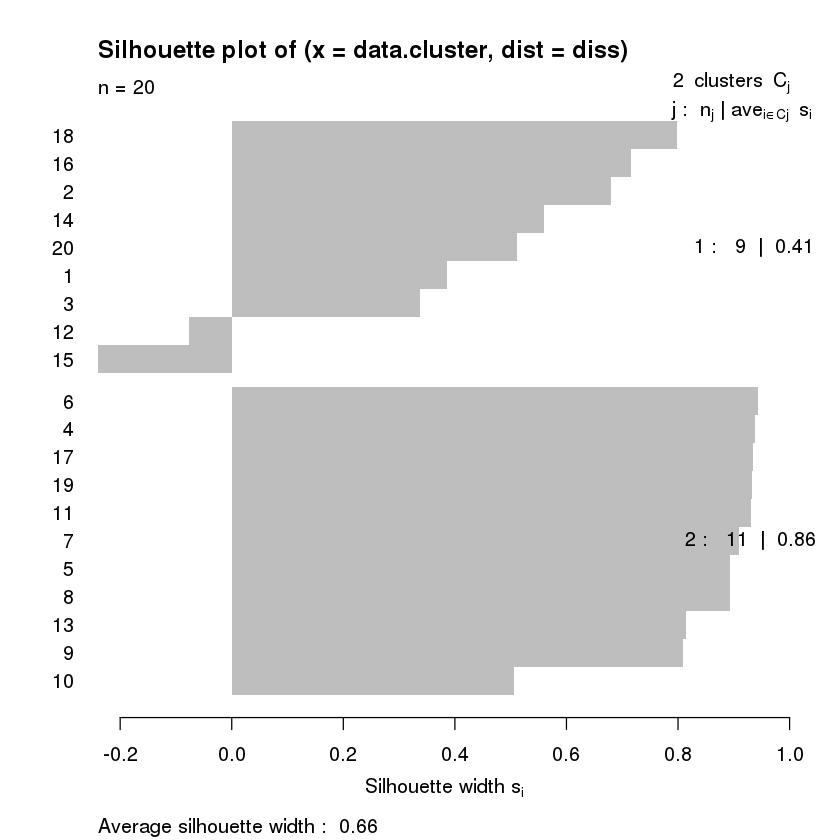

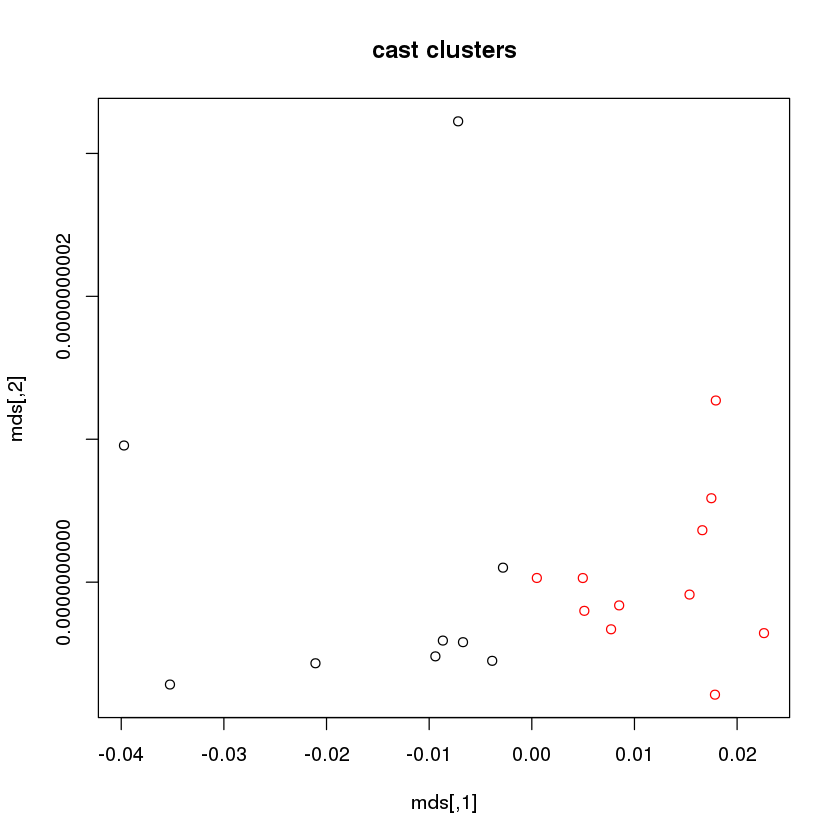

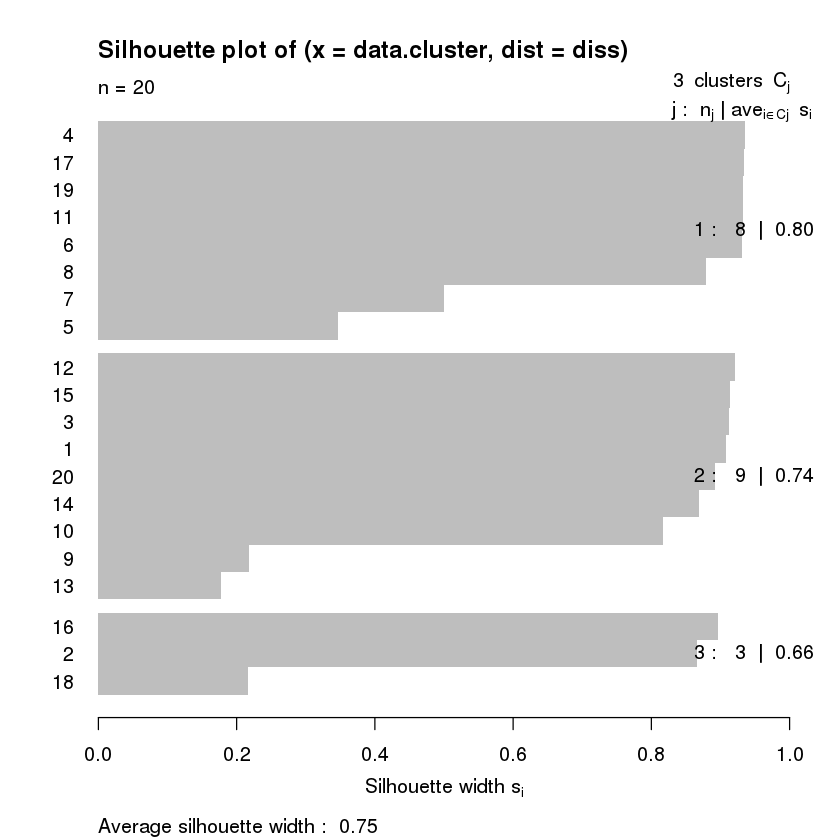

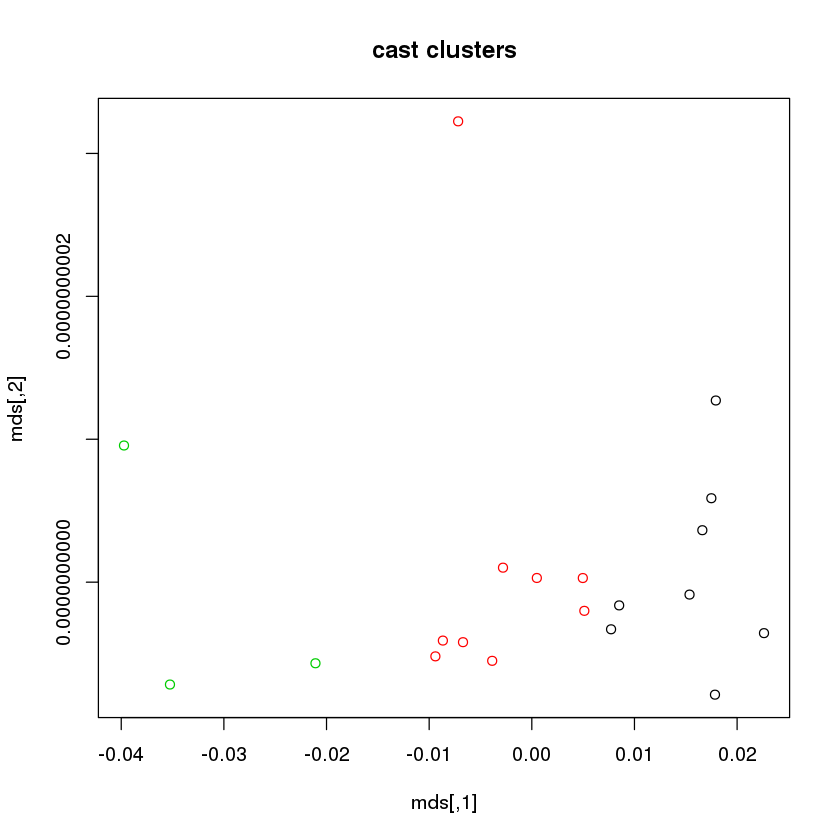

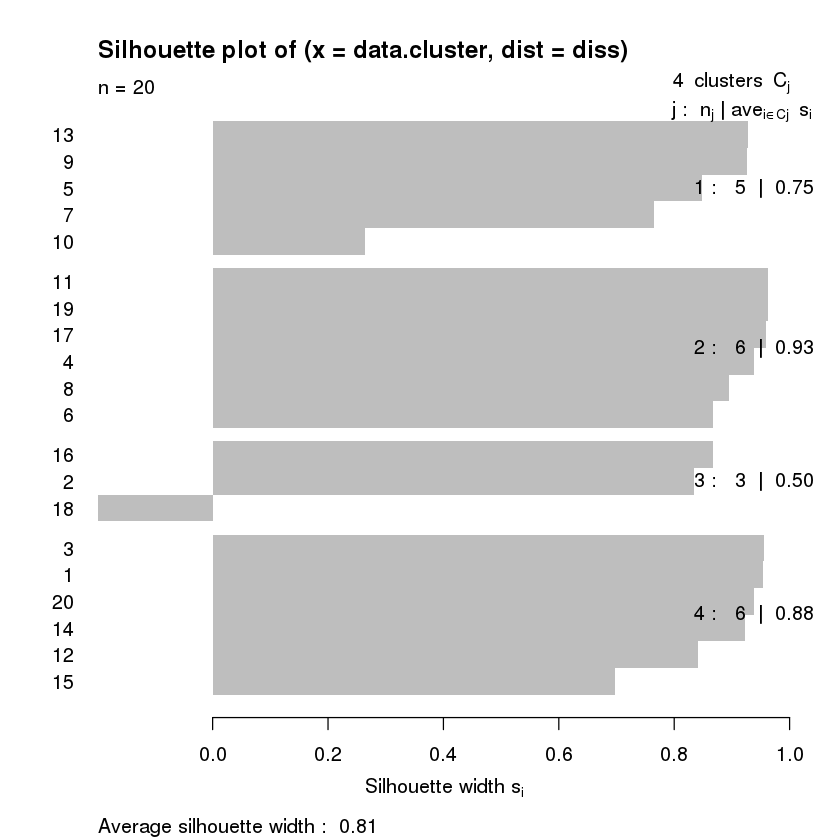

...

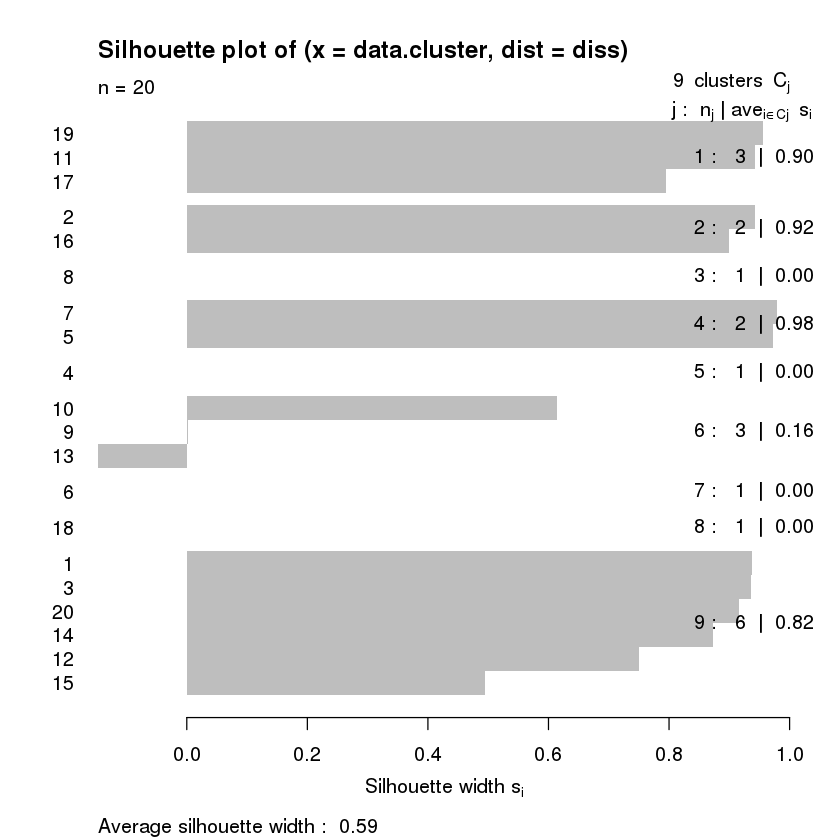

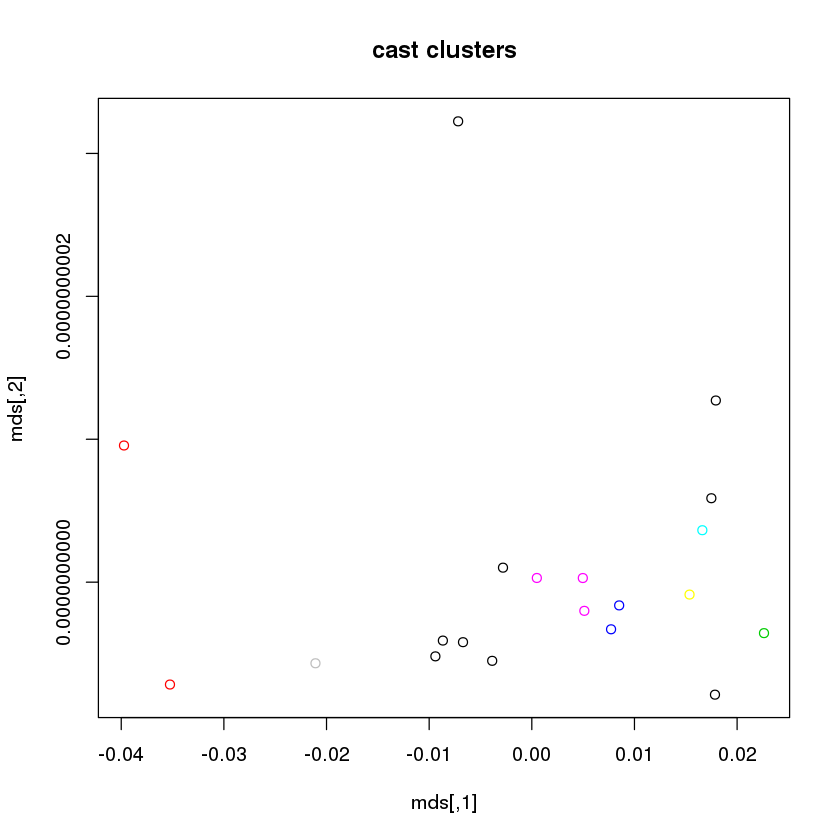

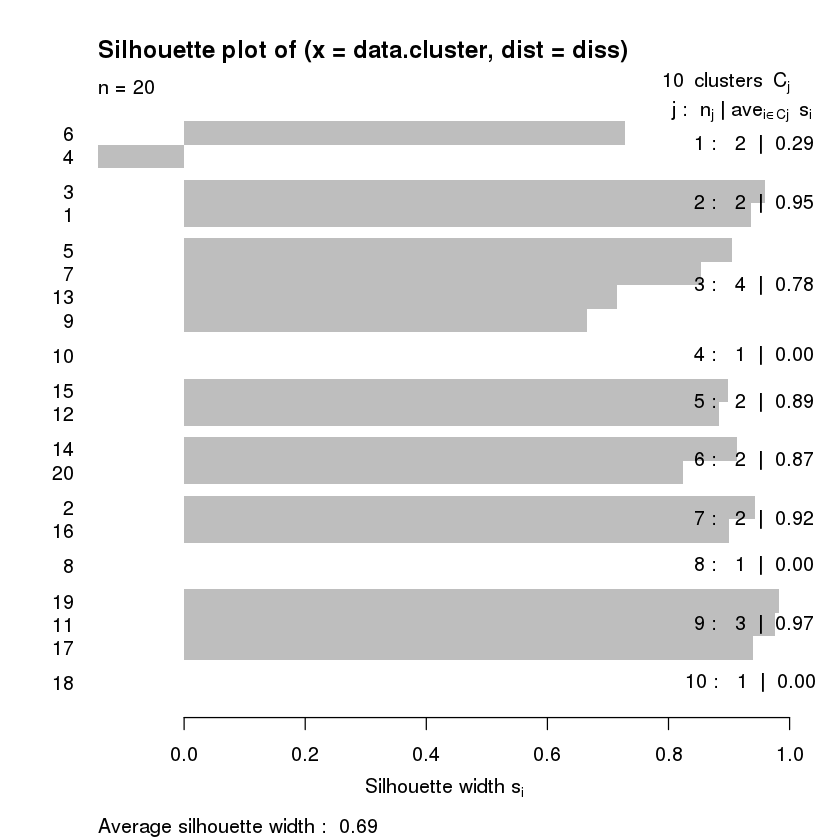

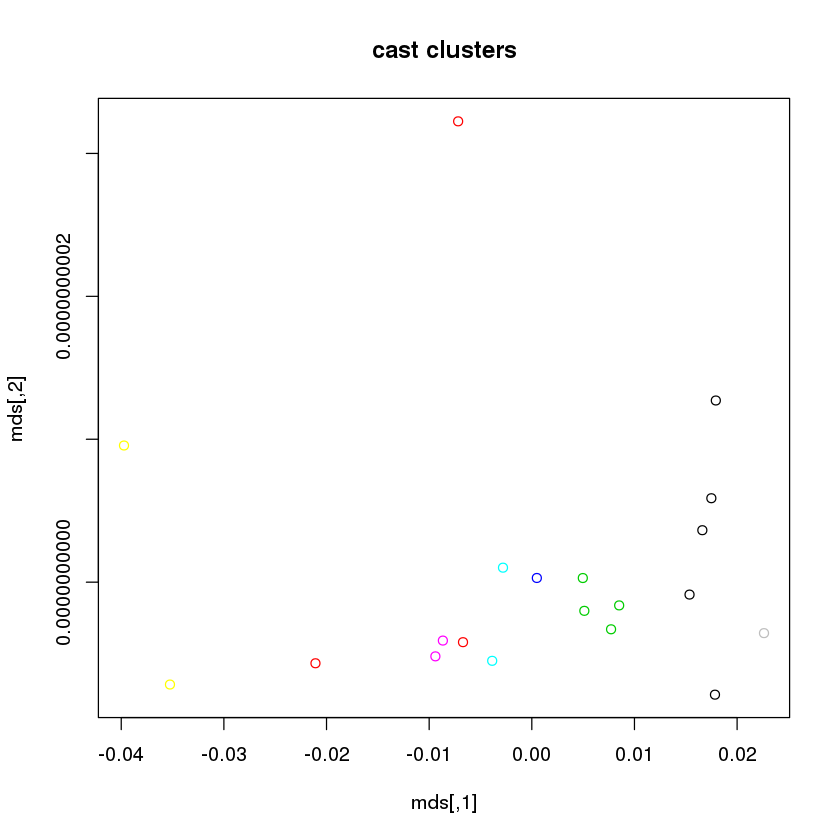

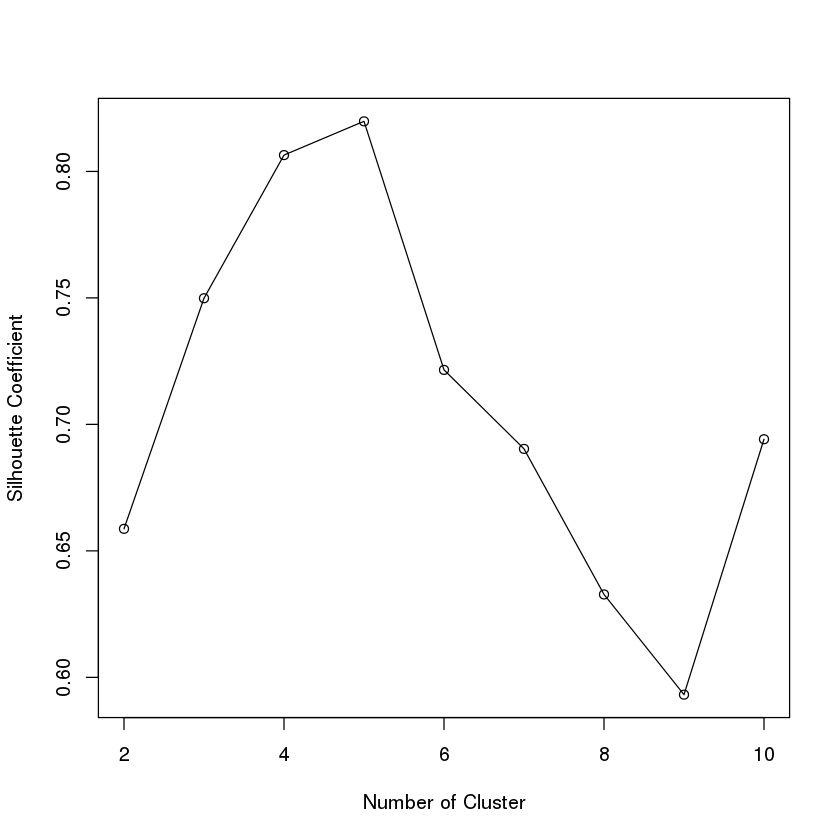

In [82]:
try.cluster.num.func(similar.matrix)# nb cosine with industy

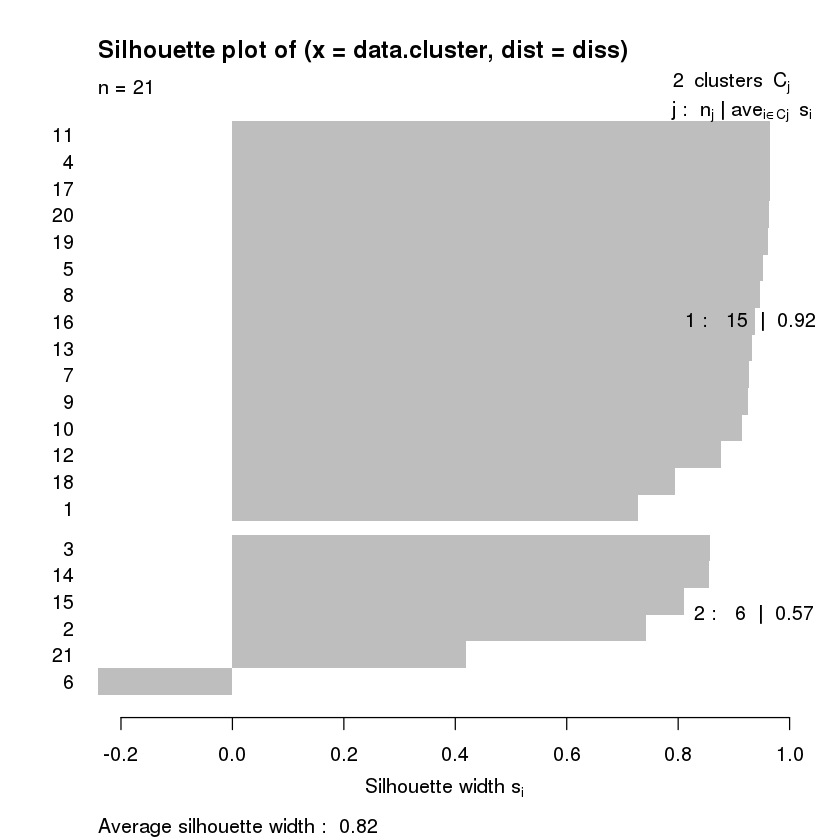

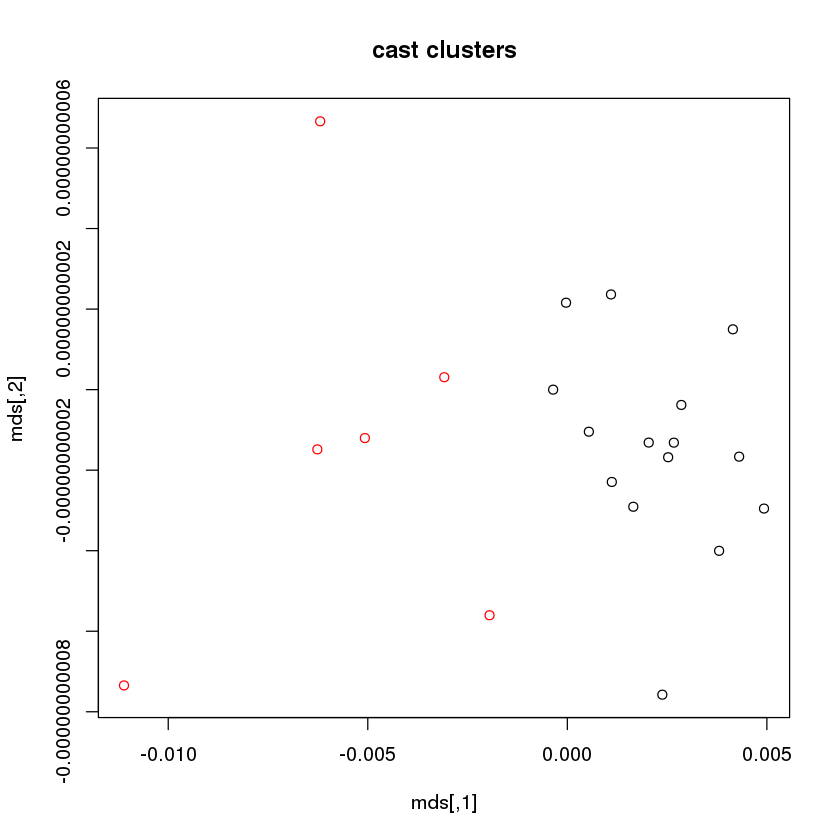

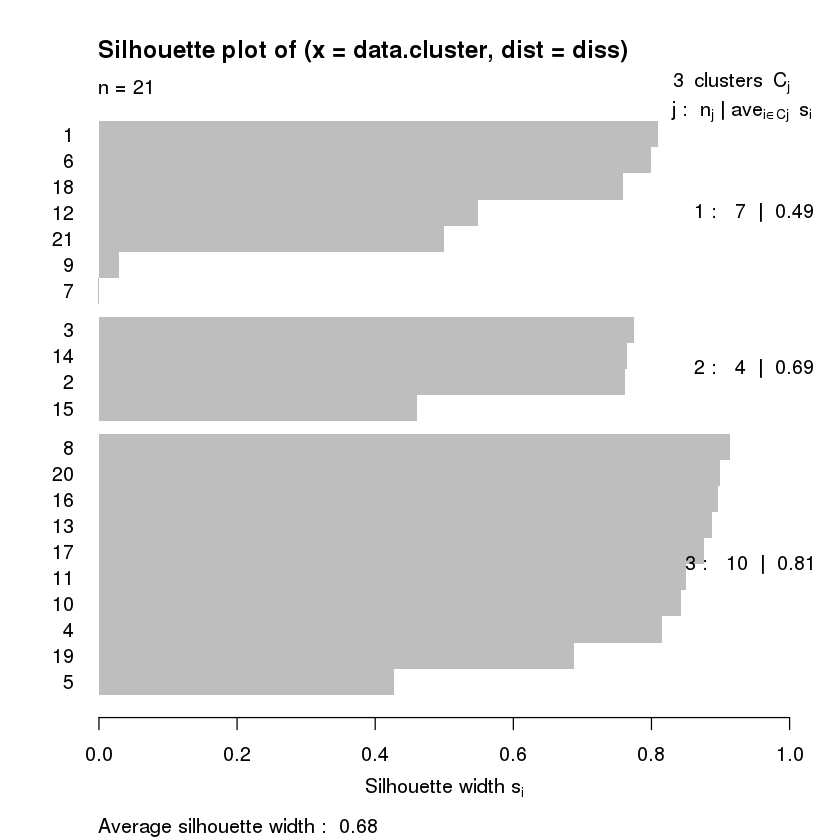

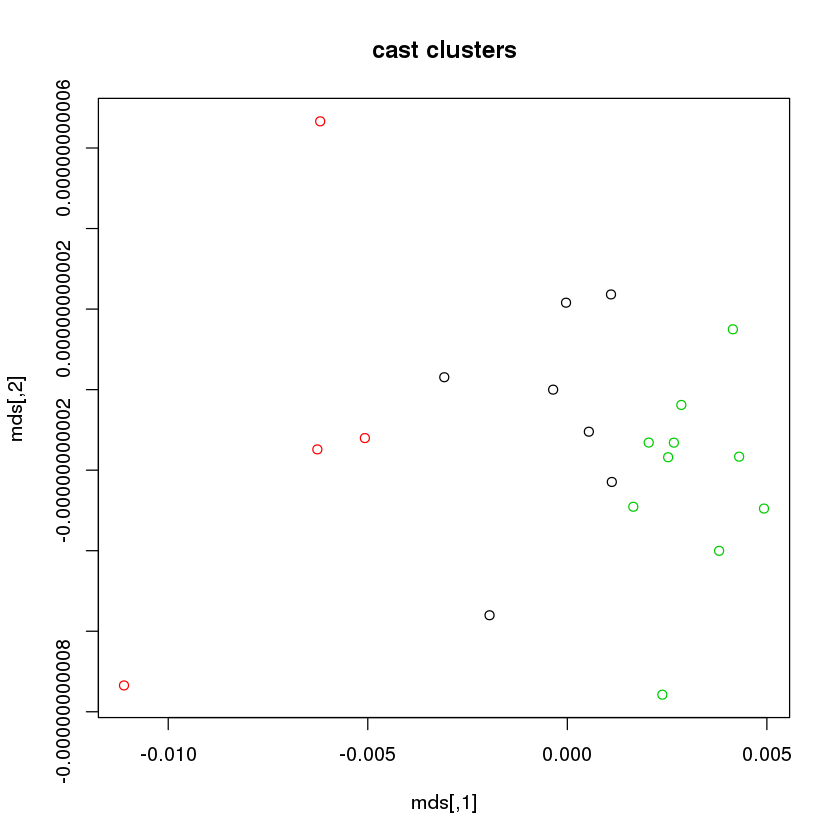

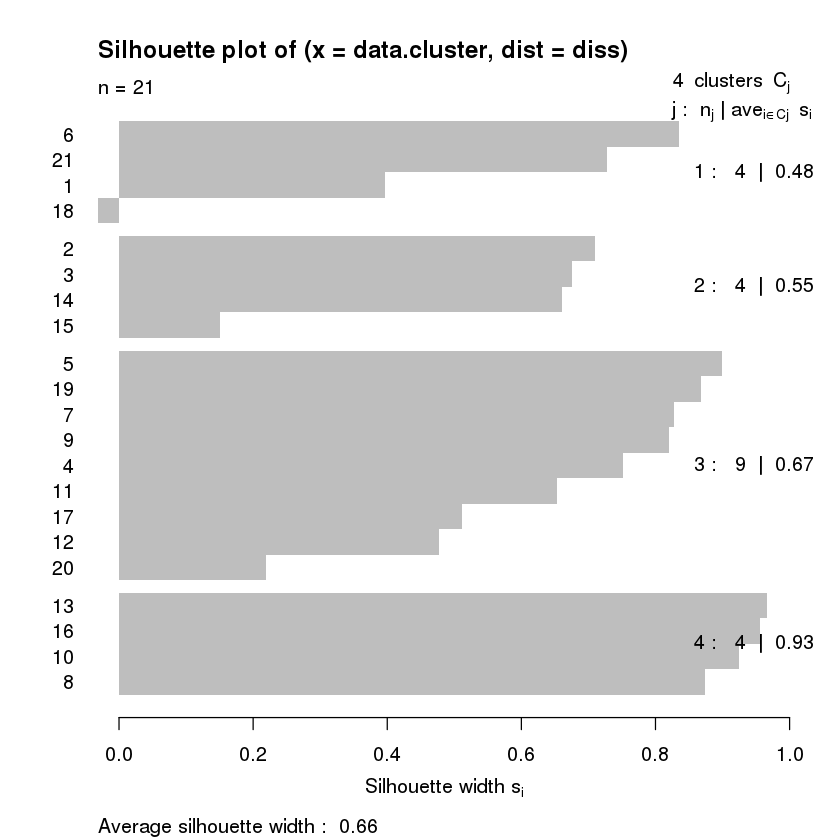

...

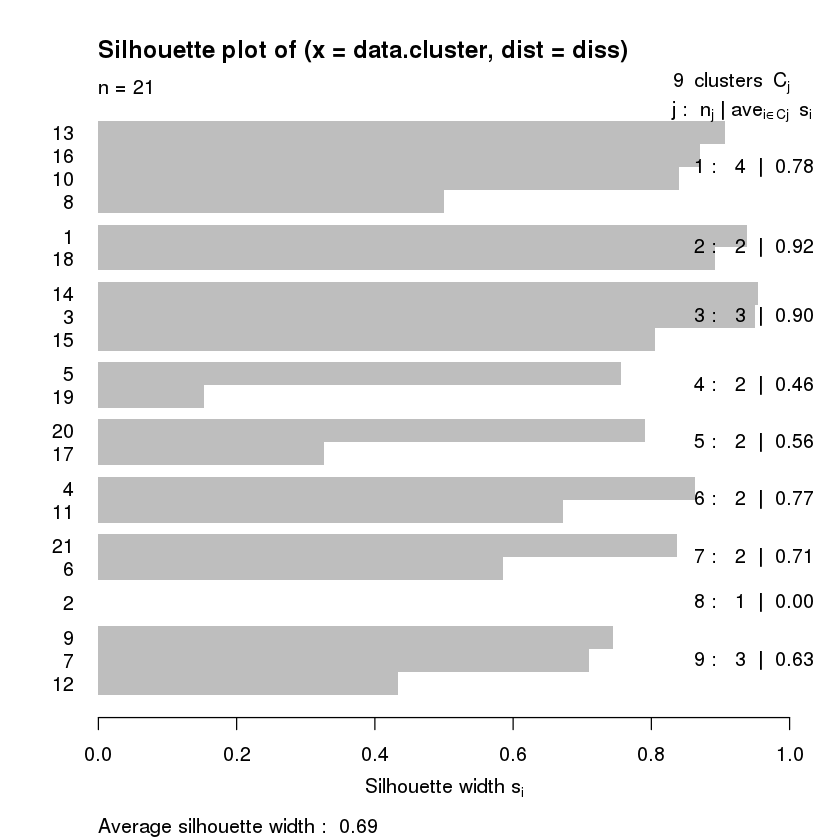

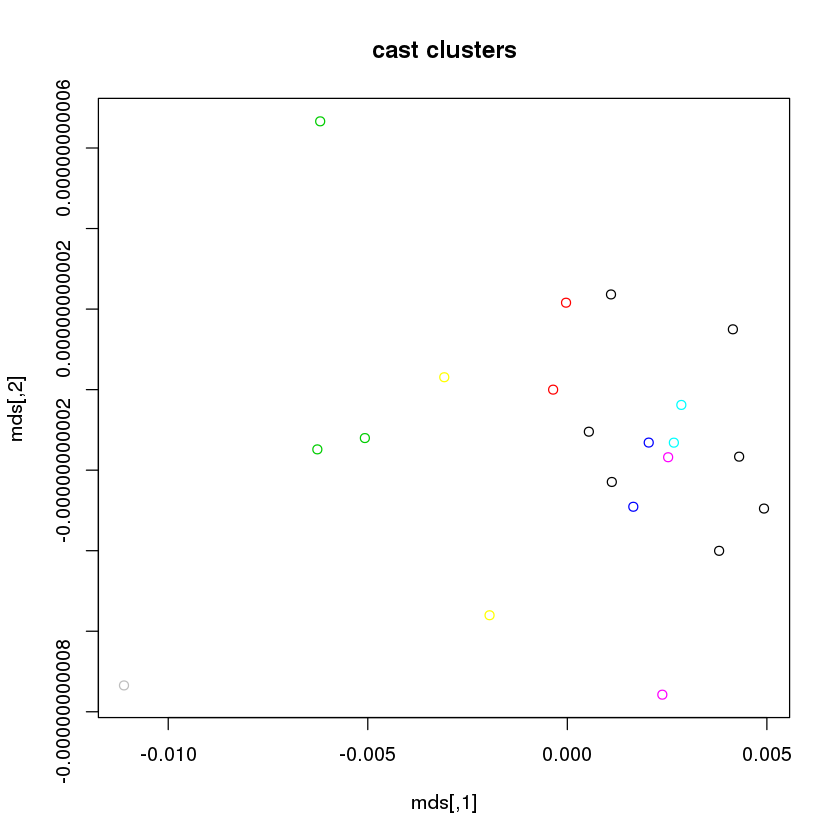

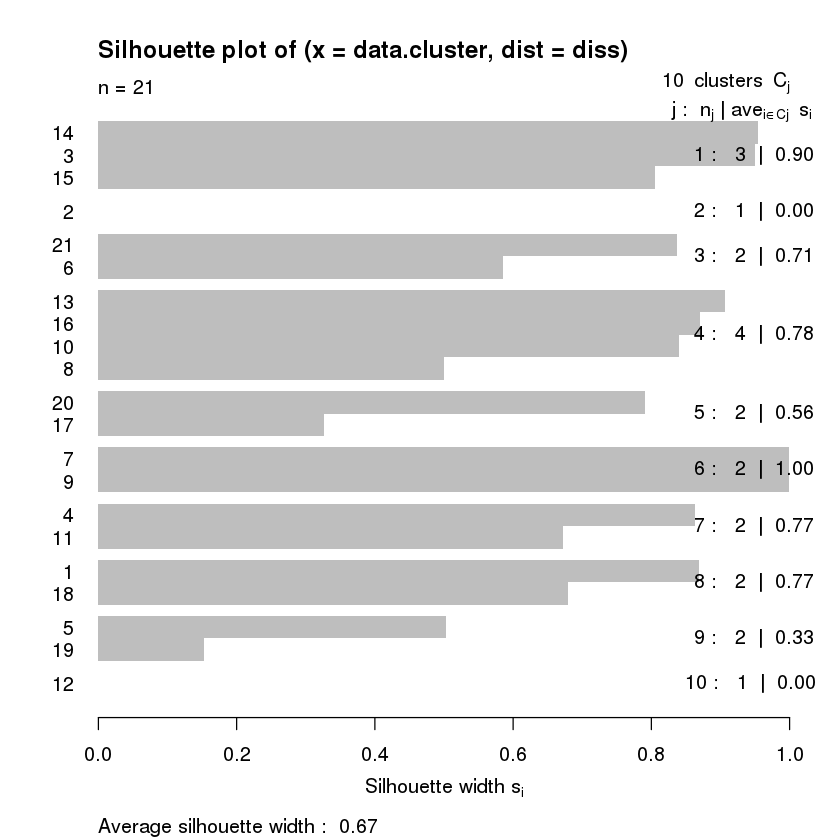

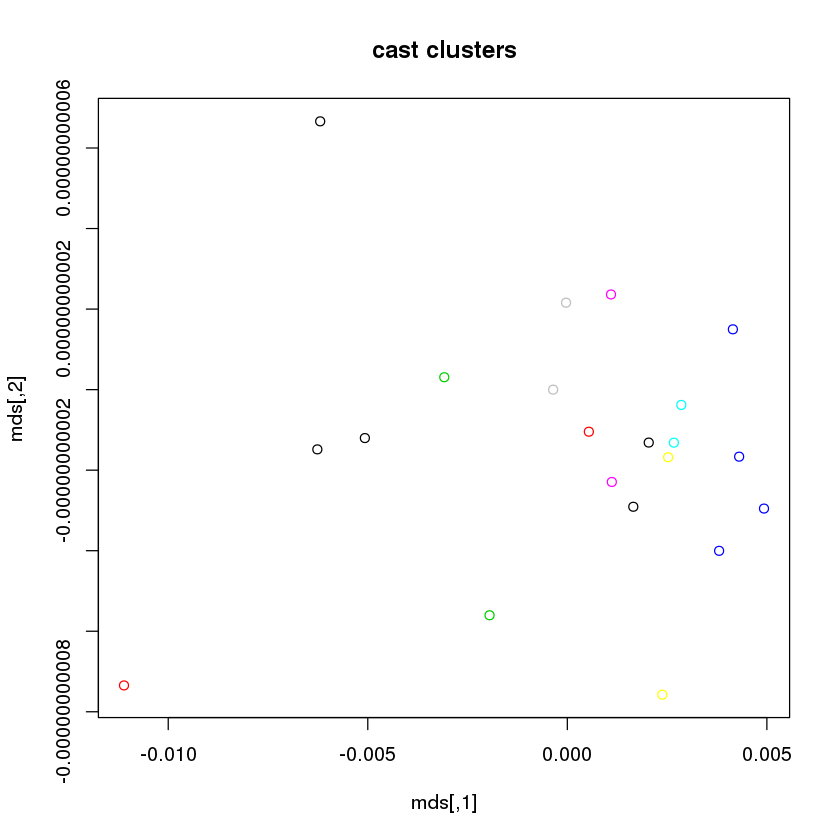

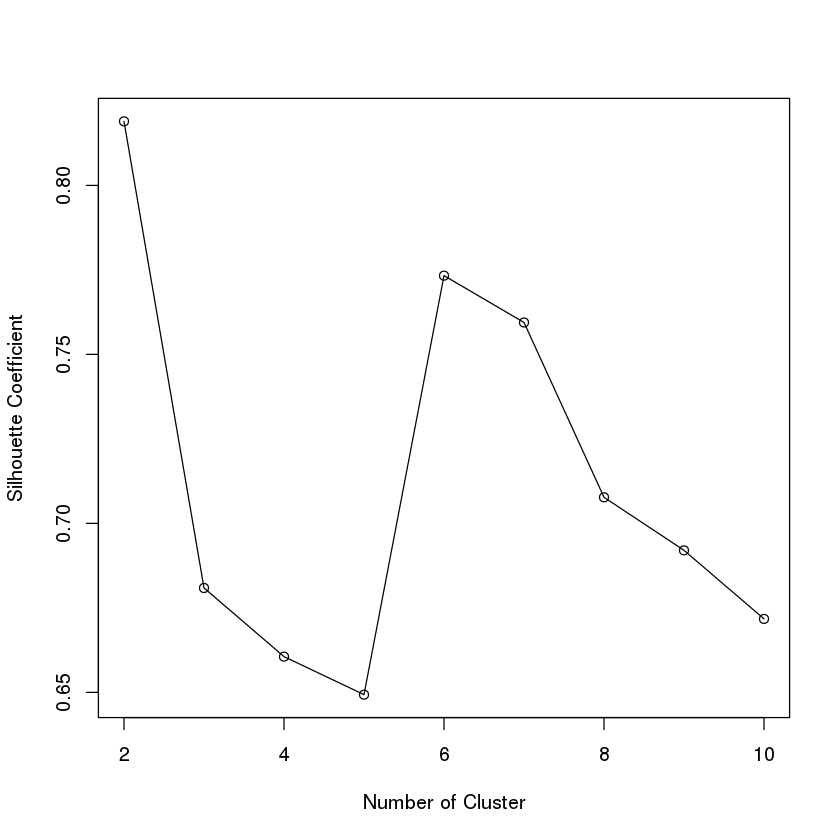

In [51]:
try.cluster.num.func(similar.matrix)# nb cosine

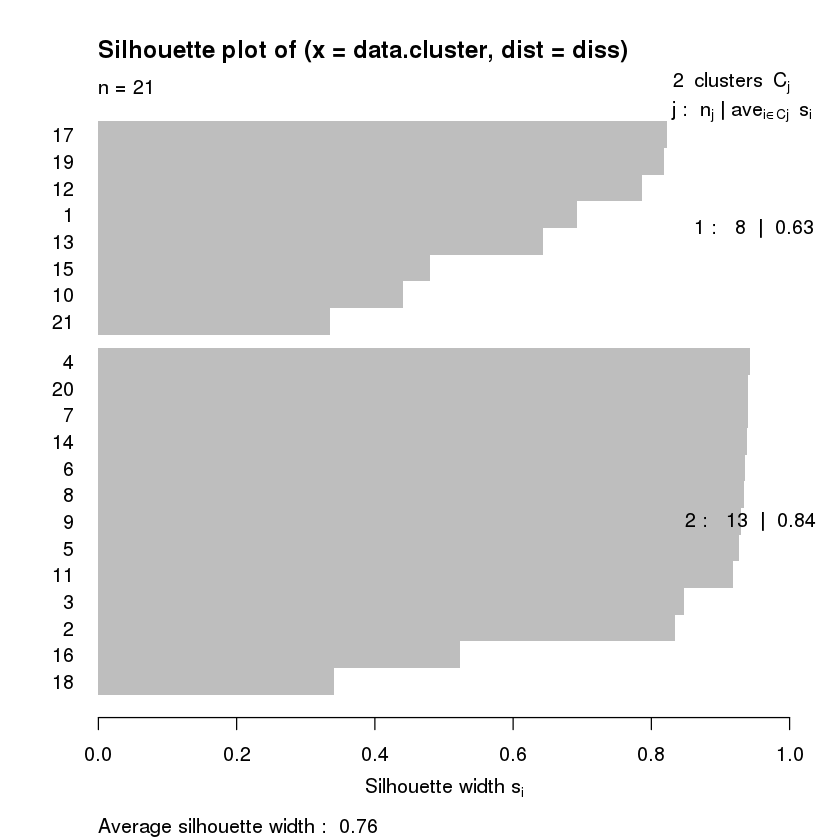

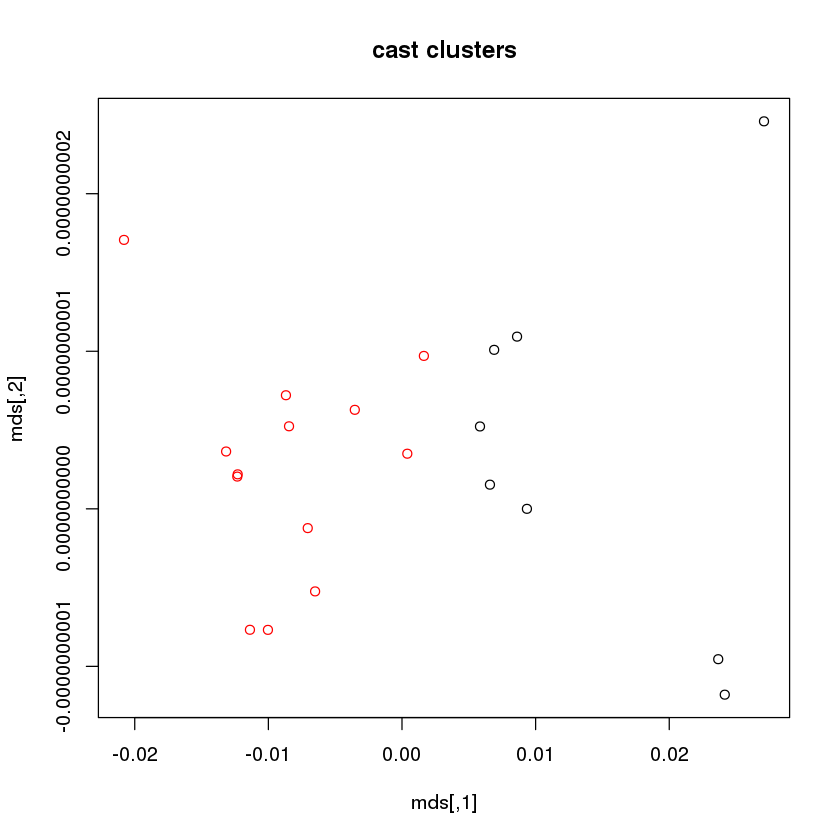

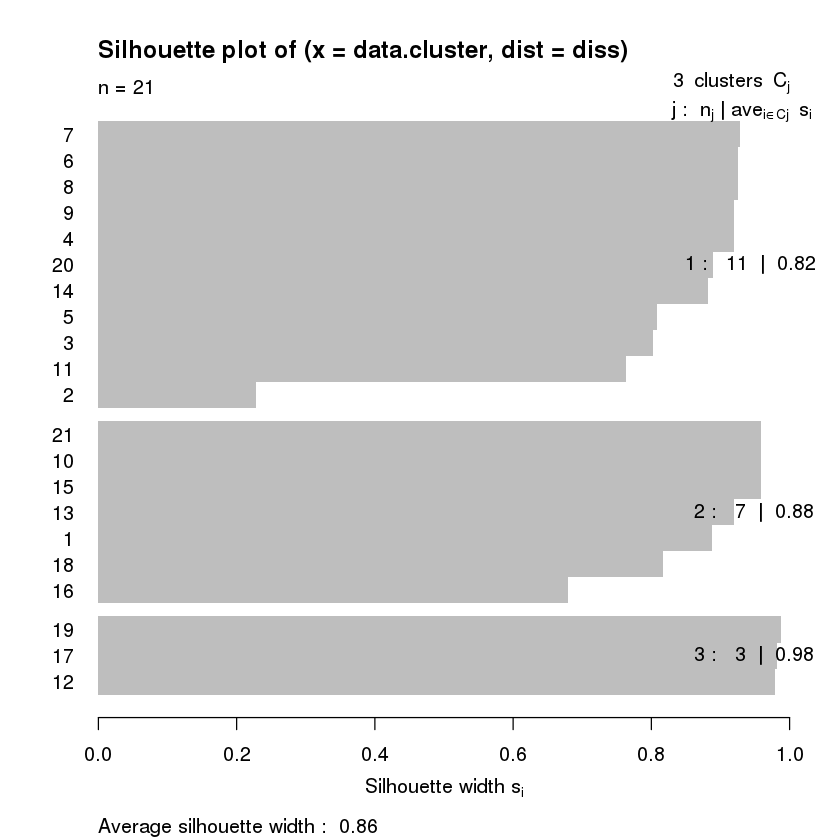

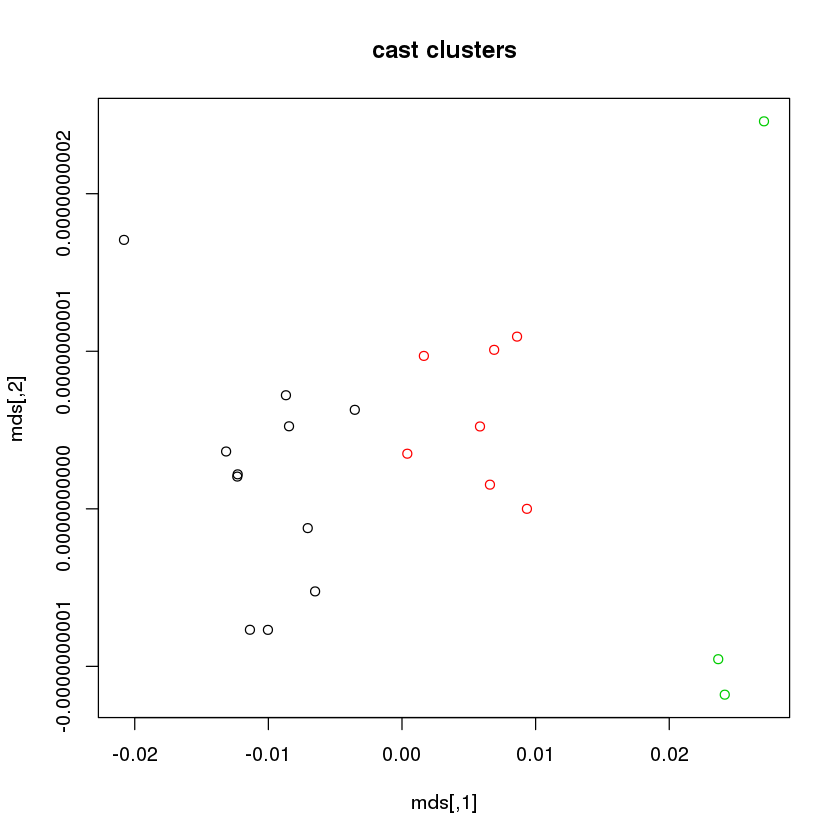

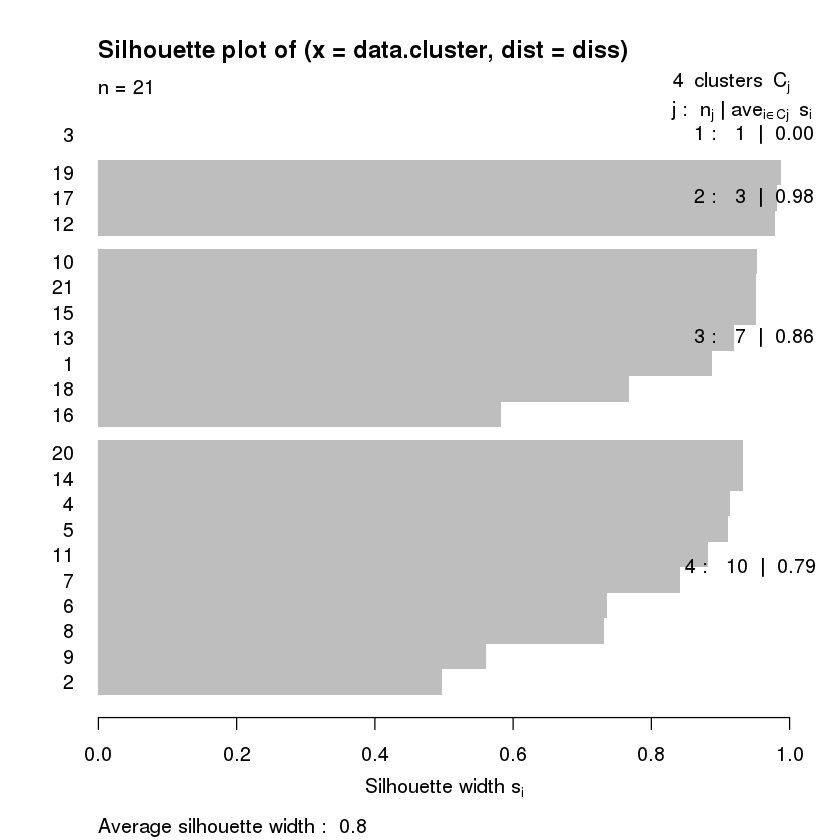

...

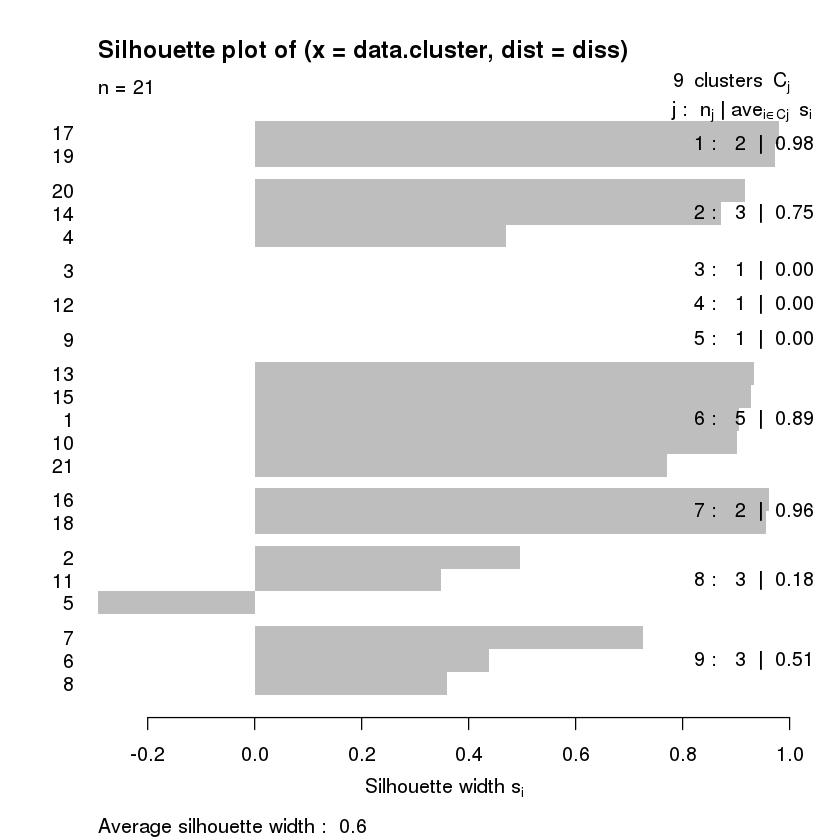

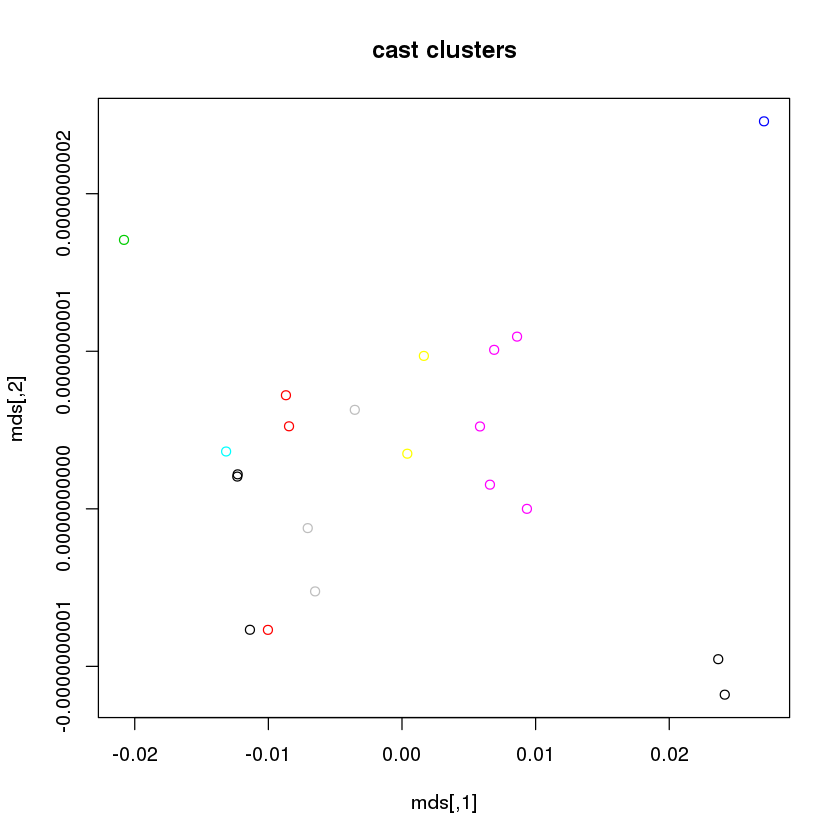

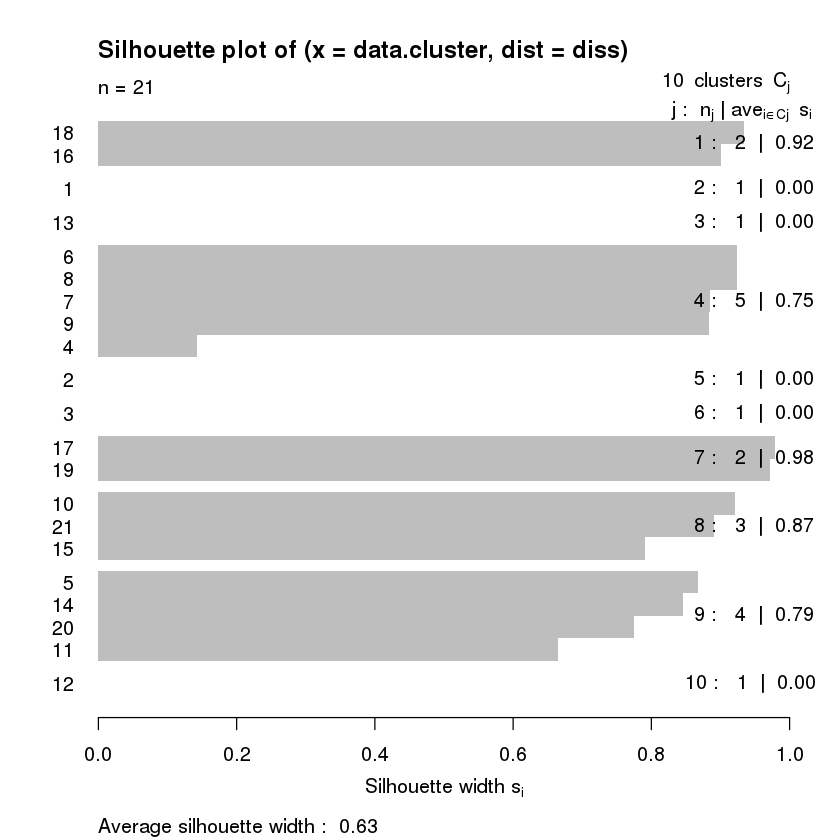

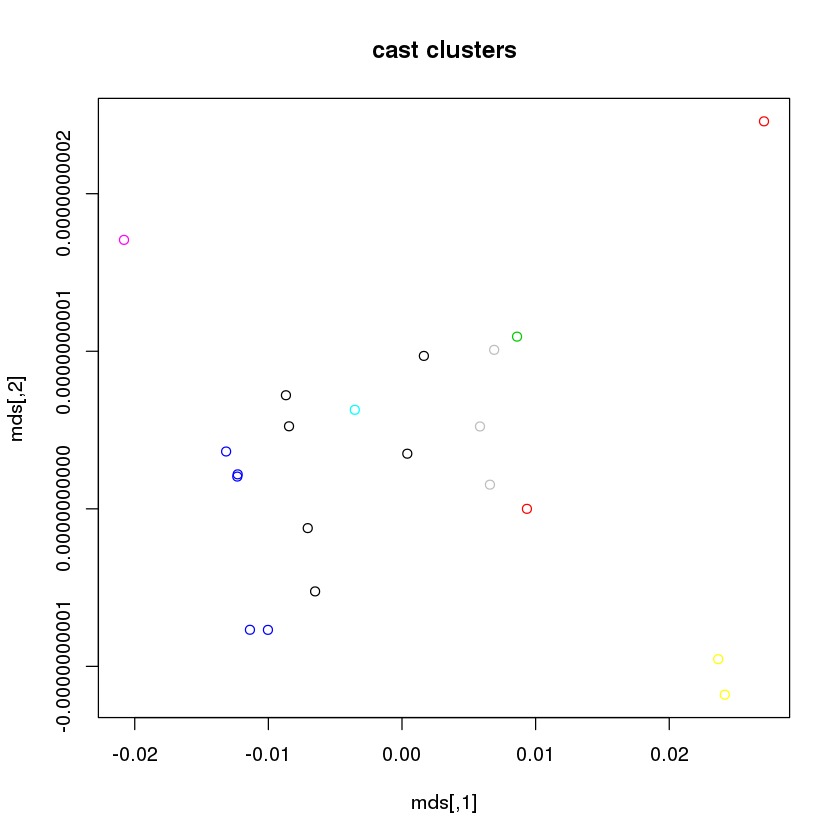

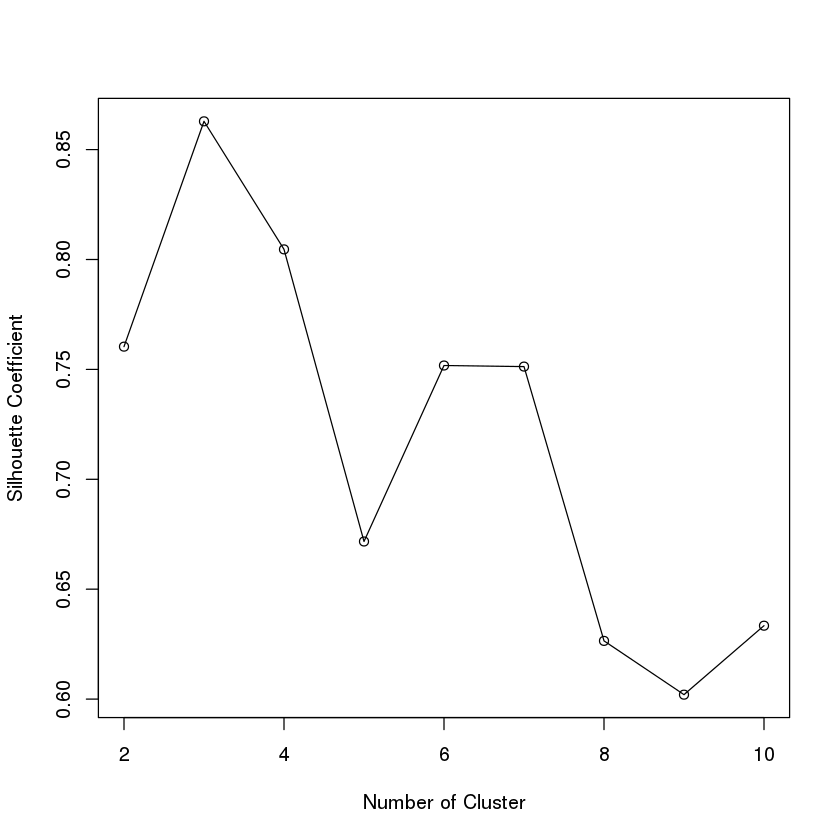

In [37]:
try.cluster.num.func(similar.matrix) # wmd euc

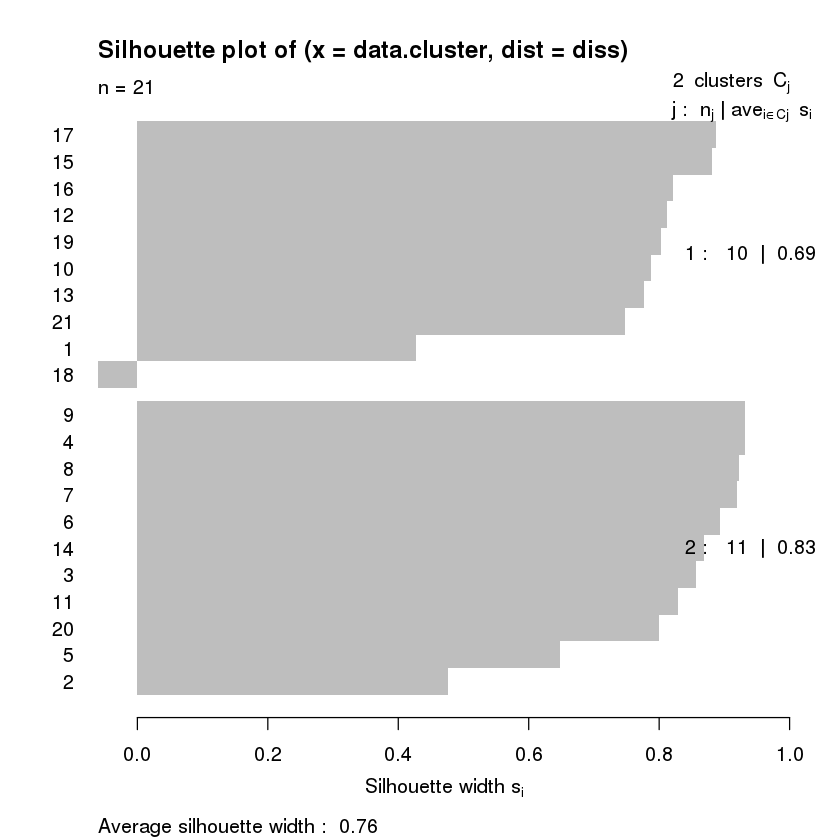

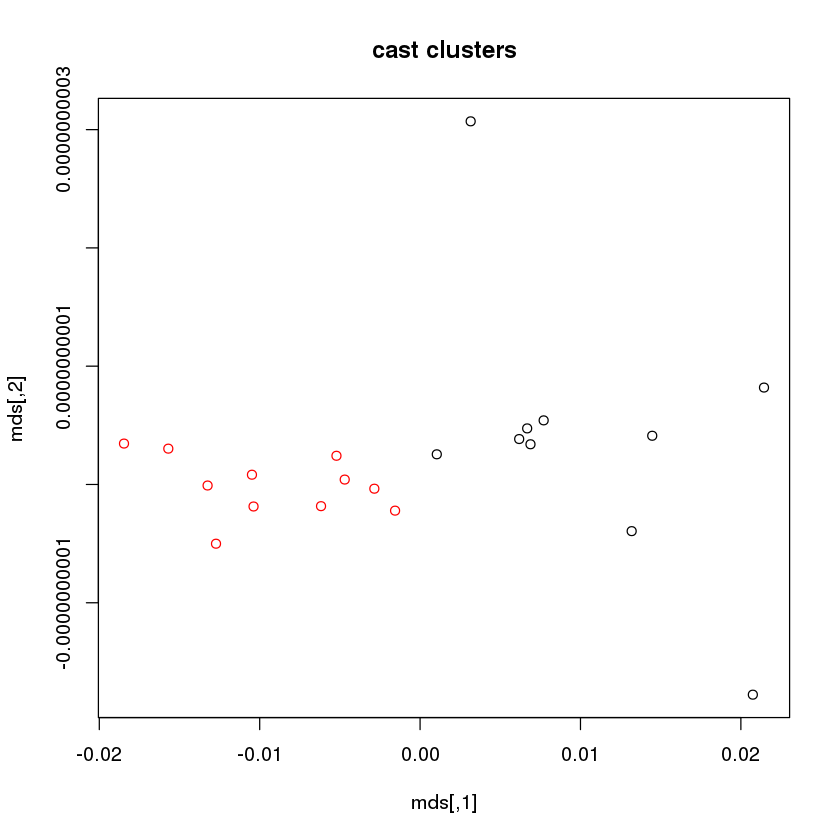

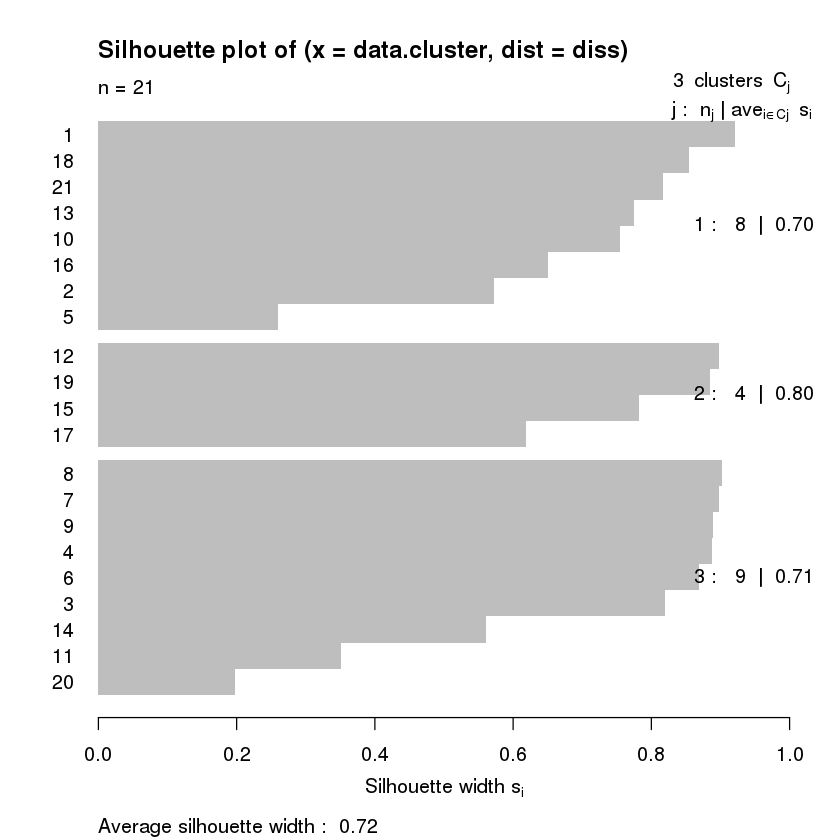

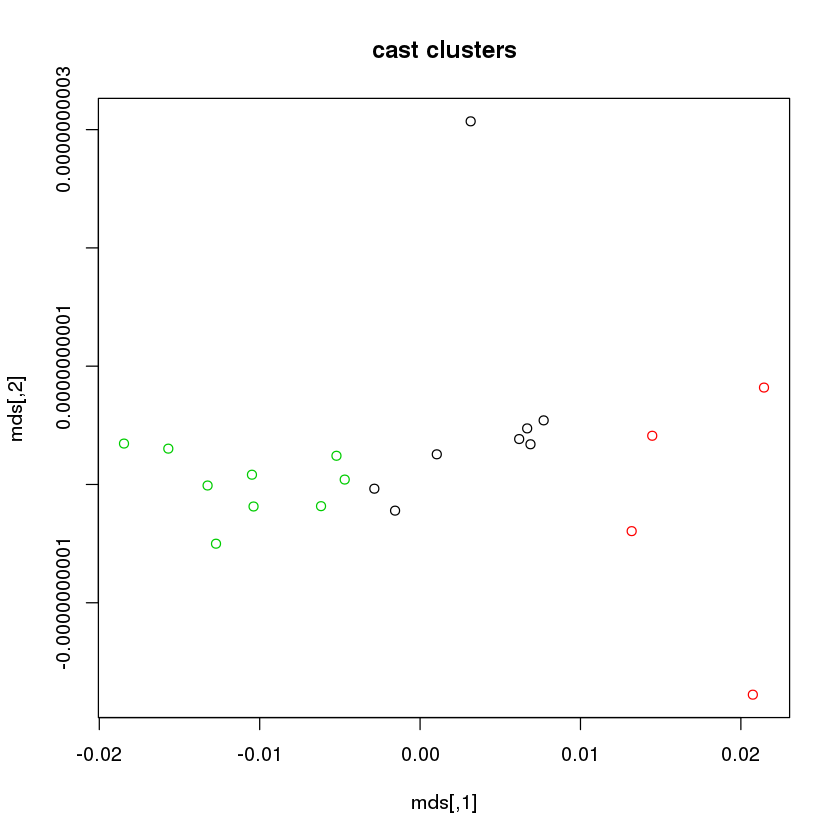

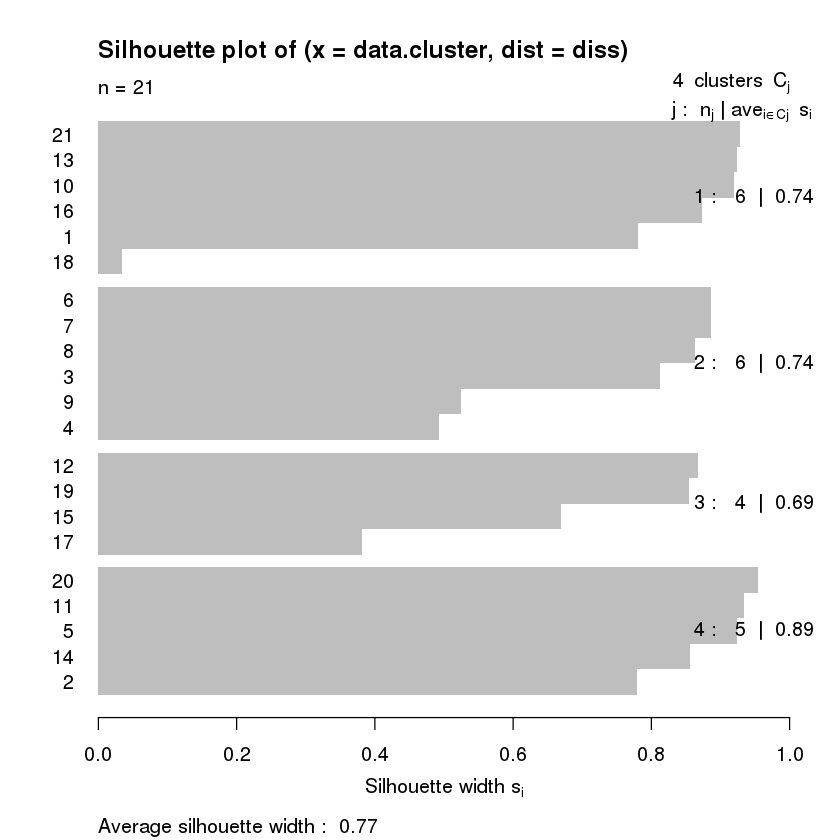

...

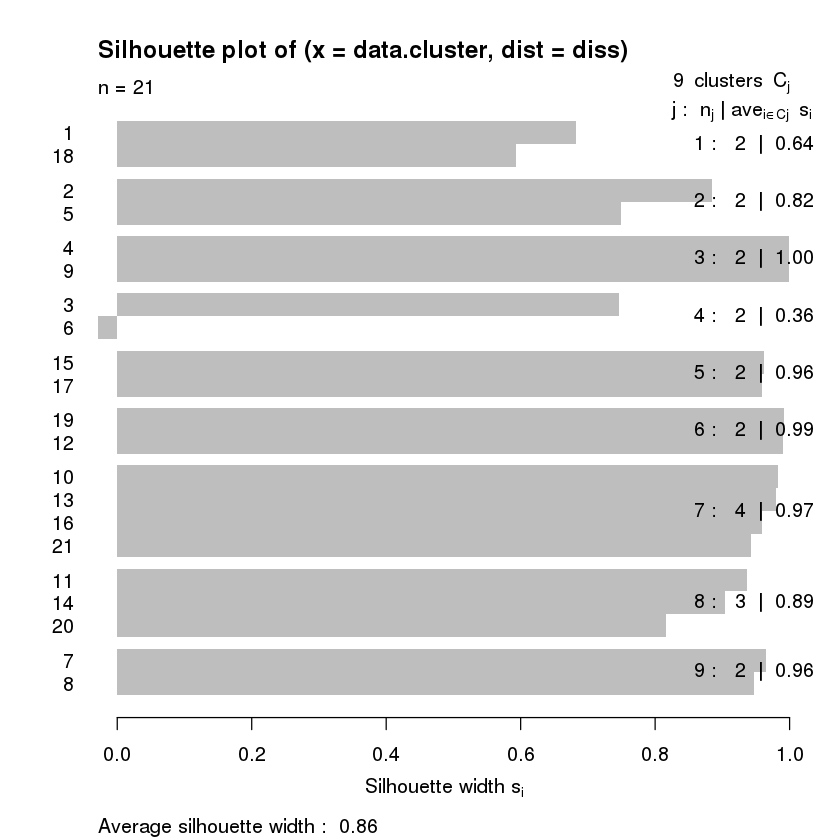

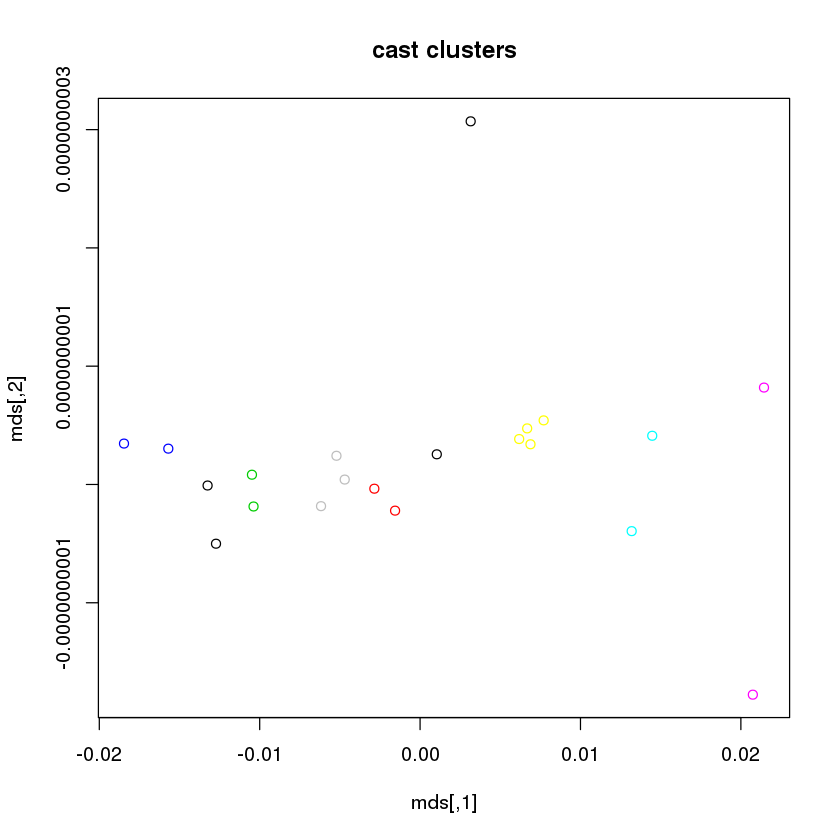

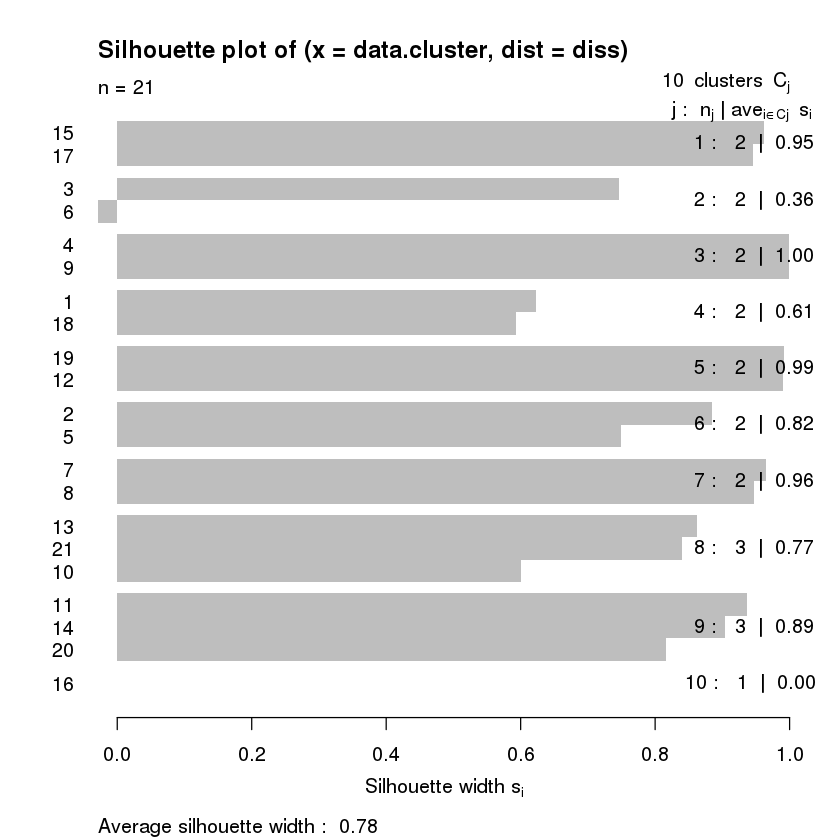

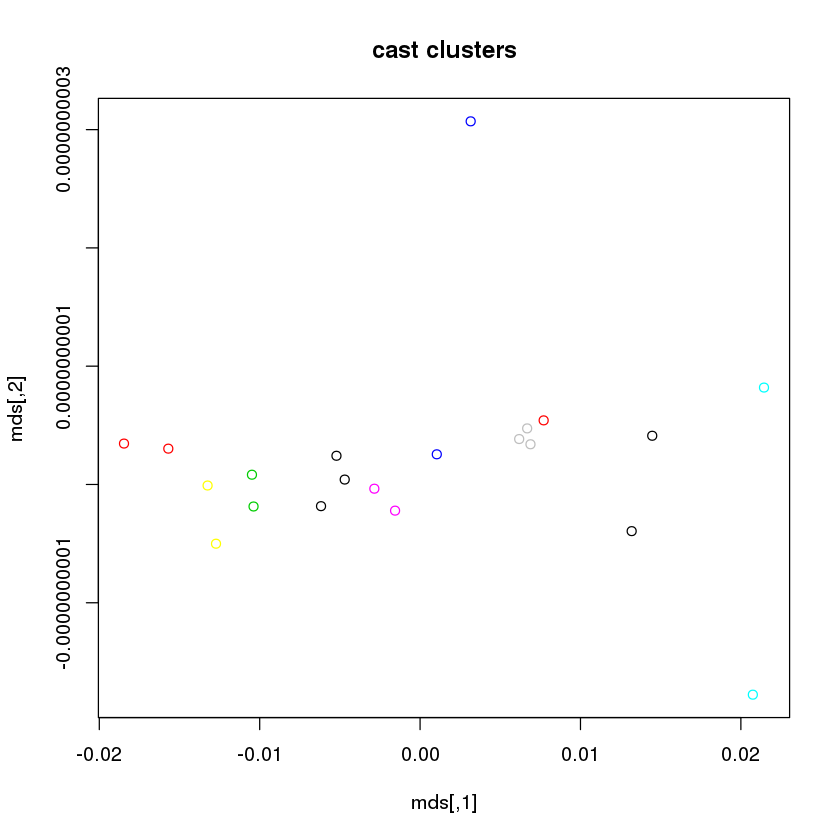

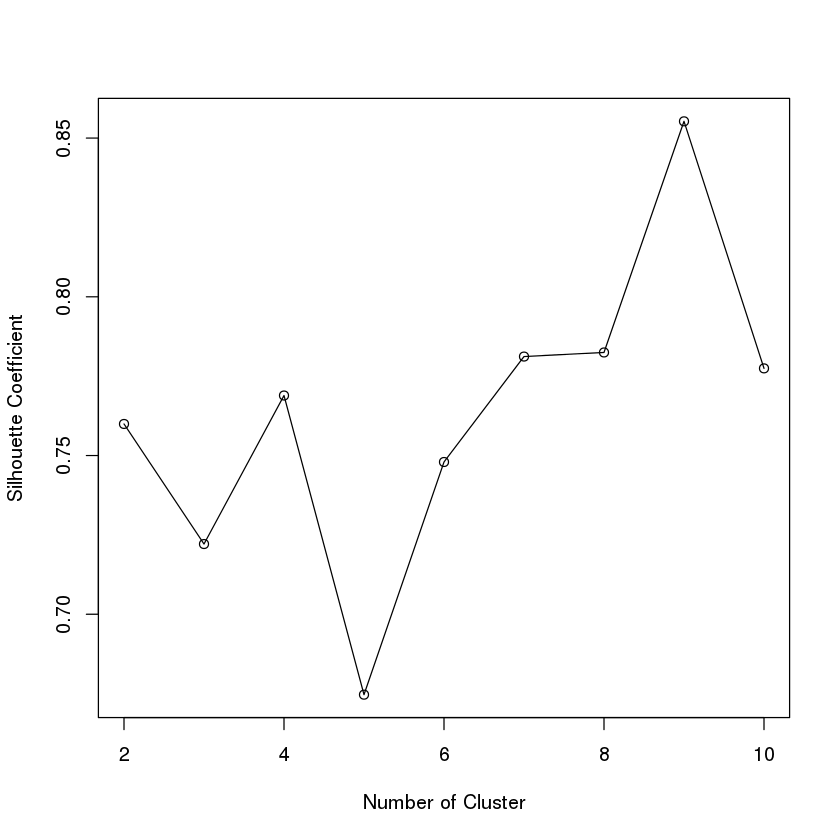

In [21]:
try.cluster.num.func(similar.matrix) # wmd cosine

In [83]:
var = list("mat"=similar.matrix, "num"=5)

cls <- spectral.clustering.func(var)


In [84]:
#cls$cluster$cluster
detail <- stat.res.func(similar.matrix, cls$cluster$cluster)

In [125]:
raw.file <- "/data/users/jiancheng.zhai/project/advertiser_cluster/data/finance/pyid_wcos/week_data"
raw.data <- read.file.func(raw.file)
colnames(raw.data) <- c("pyid", "company_id")

In [130]:
colnames(raw.data) <- c("pyid", "company_id")
stat.uv <- tapply(raw.data$pyid, raw.data$company_id, FUN = function(x) length(unique(x)))
stat.uv.data <- as.data.frame(stat.uv)
colnames(stat.uv.data) <- c("uv")
stat.uv.data$company_id <- row.names(stat.uv.data)
merge.data <- merge(merge.data, stat.uv.data, by="company_id", all.x=T, all.y=F)

In [56]:
detail #nb cosine

,company_id,cluster,name,class,raw_data,ad_id,uv
3,1232,1,广东俊特团贷网络信息服务股份有限公司,P2P平台,金融类/P2P平台,10592,138022
4,1232,1,广东俊特团贷网络信息服务股份有限公司,P2P平台,金融类/P2P平台,4723,138022
5,1423,1,平安陆金所,P2P平台,金融类/P2P平台,5777,251803
6,1423,1,陆金所,P2P平台,金融类/P2P平台,8565,251803
11,2527,1,浙江小融网络科技有限公司,债券,金融类/债券,8194,113768
19,4038,1,开鑫贷,P2P平台,金融类/P2P平台,10402,23859
20,4101,1,宁波合众芸创财富投资管理有限公司,P2P平台,金融类/P2P平台,10469,160294
26,5198,1,郑州易保网络科技有限公司,保险,金融类/保险,12008,27599
1,1209,2,杭州投融界网络有限公司,P2P平台,金融类/P2P平台,9730,231992
2,1209,2,杭州投融界网络有限公司,P2P平台,金融类/P2P平台,4450,231992


In [40]:
detail #wmd euc

,company_id,cluster,name,class,raw_data,ad_id,uv
3,1232,1,广东俊特团贷网络信息服务股份有限公司,P2P平台,金融类/P2P平台,10592,138022
4,1232,1,广东俊特团贷网络信息服务股份有限公司,P2P平台,金融类/P2P平台,4723,138022
5,1423,1,平安陆金所,P2P平台,金融类/P2P平台,5777,251803
6,1423,1,陆金所,P2P平台,金融类/P2P平台,8565,251803
7,1514,1,鑫合汇,P2P投资理财,金融类/P2P平台/P2P投资理财,9830,23950
8,1514,1,鑫合汇,P2P投资理财,金融类/P2P平台/P2P投资理财,6032,23950
9,1572,1,网易贵金属,其他金融类,金融类/其他金融类,10441,81650
10,1572,1,贵金属移动端,贵金属,金融类/期货/贵金属,11678,81650
11,2527,1,浙江小融网络科技有限公司,债券,金融类/债券,8194,113768
12,2600,1,浙江广众金融服务外包有限公司,P2P投资理财,金融类/P2P平台/P2P投资理财,8283,47212


In [26]:
detail #wmd cos 

,company_id,cluster,name,class,raw_data,ad_id,uv
22,4986,1,恒信贵金属有限公司,其他金融类,金融类/其他金融类,11688,313715
17,3903,2,卡卡贷,其他金融类,金融类/其他金融类,10220,22632
24,5030,2,益盟,股票基金,金融类/证券/股票基金,11751,29577
16,3811,3,好车贷,P2P平台,金融类/P2P平台,10121,34540
19,4038,3,开鑫贷,P2P平台,金融类/P2P平台,10402,23859
25,5155,3,浙江温商贷互联网金融服务有限公司,P2P投资理财,金融类/P2P平台/P2P投资理财,11939,291206
7,1514,4,鑫合汇,P2P投资理财,金融类/P2P平台/P2P投资理财,9830,23950
8,1514,4,鑫合汇,P2P投资理财,金融类/P2P平台/P2P投资理财,6032,23950
12,2600,4,浙江广众金融服务外包有限公司,P2P投资理财,金融类/P2P平台/P2P投资理财,8283,47212
13,2772,4,宜信投米,P2P投资理财,金融类/P2P平台/P2P投资理财,8441,37601


In [164]:
as.data.frame(unique(detail$company_id))

,unique(detail$company_id)
1,4561
2,1572
3,1800
4,2392
5,2740
6,3951
7,1178
8,1514
9,2025
10,2257
